In [45]:
import snap
import re

# ENCRYPT COZ POST ID CAN ONLY BE INT

def convert_to_integer(post_id):
    base = 36  # 10 digits + 26 letters

    # Remove leading and trailing single quotes if present
    post_id = post_id.strip("'")

    # Convert each character to its corresponding integer value
    int_values = [int(c, base) for c in post_id]

    # Combine the integer values to get a unique integer for the whole string
    result = 0
    for value in int_values:
        result = result * base + value

    return result

# Create a graph
G = snap.TNEANet.New()

# Read data from file
with open('formatted_data_file.txt', 'r') as file:
    data = file.read()

# Split the data into lines
lines = data.strip().split('\n')

# Mapping between community names and their node IDs
community_to_id = {}

# Add nodes and edges to the graph
for line in lines:
    # Split the line using either tab or space as the separator
    parts = re.split(r'\t|\s+', line)  

    # Extract values into variables
    source_community = parts[0]
    target_community = parts[1]
    post_id_source = parts[2]
    timestamp_source = parts[3] + " " + parts[4]  # Combine date and time
    user = parts[5]
    post_id_target = parts[6]
    timestamp_target = parts[7] + " " + parts[8]  # Combine date and time

    # Add nodes if they don't exist
    if source_community not in community_to_id:
        source_community_id = G.AddNode()
        community_to_id[source_community] = source_community_id

    if target_community not in community_to_id:
        target_community_id = G.AddNode()
        community_to_id[target_community] = target_community_id

    # Convert alphanumeric post IDs to integers
    post_id_source_int = convert_to_integer(post_id_source)
    post_id_target_int = convert_to_integer(post_id_target)

    # Add edge
    edge_id = G.AddEdge(source_community_id, target_community_id)

    # Add attributes for source and target post IDs
    G.AddIntAttrDatE(edge_id, post_id_source_int, "source_post_id")
    G.AddIntAttrDatE(edge_id, post_id_target_int, "target_post_id")
    



# Print the total number of nodes and edges
print("Total Nodes:", G.GetNodes())
print("Total Edges:", G.GetEdges())


Total Nodes: 35776
Total Edges: 286561


In [2]:
# Read label info from file and convert to a dictionary
with open('label_info.tsv', 'r') as label_file:
    label_lines = label_file.read().strip().split('\n')

# Convert label lines to a dictionary
sentiment_dict = {}
for label_line in label_lines:
    parts = label_line.split()
    if len(parts) == 3:
        post_id_from, post_id_to, sentiment = parts[0][1:-1], parts[1][:-1], parts[2]
        post_id_from_int = convert_to_integer(post_id_from)
        post_id_to_int = convert_to_integer(post_id_to)
        sentiment_dict[(post_id_from_int, post_id_to_int)] = sentiment

# Add sentiment attribute to edges
for edge in G.Edges():
    source_post_id = G.GetIntAttrDatE(edge.GetId(), "source_post_id")
    target_post_id = G.GetIntAttrDatE(edge.GetId(), "target_post_id")
    
    # Check if the post ID pair is present in the sentiment dictionary
    if (source_post_id, target_post_id) in sentiment_dict:
        sentiment_value = 1 if sentiment_dict[(source_post_id, target_post_id)] == 'burst' else 0 
        G.AddIntAttrDatE(edge.GetId(), sentiment_value, "sentiment")

In [3]:
def convert_from_integer(post_id_int):
    base = 36
    digits = []
    
    # Convert the integer to a list of digits
    while post_id_int > 0:
        digits.append(post_id_int % base)
        post_id_int //= base

    # Convert the list of digits to the original string format
    result_str = ''.join(chr(digit + ord('0')) if digit < 10 else chr(digit - 10 + ord('a')) for digit in reversed(digits))
    
    return result_str

# Open a file for writing
with open('edge_sentiments.txt', 'w') as output_file:
    # Iterate over edges
    for edge in G.Edges():
        source_post_id_int = G.GetIntAttrDatE(edge.GetId(), "source_post_id")
        target_post_id_int = G.GetIntAttrDatE(edge.GetId(), "target_post_id")
        sentiment_value = G.GetIntAttrDatE(edge.GetId(), "sentiment")

        # Map sentiment value back to 'burst' or 'non-burst'
        sentiment = 'burst' if sentiment_value == 1 else 'non-burst'

        # Convert integer IDs back to original post IDs
        source_post_id = convert_from_integer(source_post_id_int)
        target_post_id = convert_from_integer(target_post_id_int)

        # Print to console
        print(f"From Post: {source_post_id}, To Post: {target_post_id}, Sentiment: {sentiment}")

        # Write to file
        output_file.write(f"From Post: {source_post_id}, To Post: {target_post_id}, Sentiment: {sentiment}\n")


From Post: 1u4nrp, To Post: 1u4lo2, Sentiment: non-burst
From Post: 1u4qkd, To Post: 1u4muc, Sentiment: non-burst
From Post: 1u4qlz, To Post: 1u4pss, Sentiment: non-burst
From Post: 1u4sjv, To Post: 1u4mjo, Sentiment: non-burst
From Post: 1u4w5s, To Post: 1u54ij, Sentiment: non-burst
From Post: 1u4w7b, To Post: 1u4yal, Sentiment: non-burst
From Post: 1u4wfe, To Post: 1u4sow, Sentiment: non-burst
From Post: 1u50po, To Post: 1u4o4u, Sentiment: non-burst
From Post: 1u5ccu, To Post: 1u5e1w, Sentiment: non-burst
From Post: 1u5ccu, To Post: 1u5mot, Sentiment: non-burst
From Post: 1u5df2, To Post: 1ujxr4, Sentiment: non-burst
From Post: 1u5iet, To Post: 1u5ivk, Sentiment: non-burst
From Post: 1u5iet, To Post: 1u5mot, Sentiment: non-burst
From Post: 1u5k33, To Post: 1u5jsk, Sentiment: burst
From Post: 1u5olg, To Post: 1uazr5, Sentiment: non-burst
From Post: 1u5q84, To Post: 1u5qhh, Sentiment: burst
From Post: 1u5qg2, To Post: 1u5if1, Sentiment: non-burst
From Post: 1u5r7j, To Post: 1u5n90, Sen

From Post: 25fhu4, To Post: 25euxb, Sentiment: non-burst
From Post: 25fhv8, To Post: 26fpuq, Sentiment: non-burst
From Post: 25fhyl, To Post: 25cvz3, Sentiment: non-burst
From Post: 25fi6d, To Post: 24apic, Sentiment: non-burst
From Post: 25fi6d, To Post: 24a8mx, Sentiment: non-burst
From Post: 25fi6d, To Post: 24p4qw, Sentiment: non-burst
From Post: 25fi97, To Post: 25cmtm, Sentiment: non-burst
From Post: 25fijr, To Post: 25dytw, Sentiment: non-burst
From Post: 25finm, To Post: 25fihh, Sentiment: non-burst
From Post: 25fjc1, To Post: 25c83n, Sentiment: non-burst
From Post: 25fjsw, To Post: 25ek68, Sentiment: non-burst
From Post: 25fjwf, To Post: 25dnp7, Sentiment: non-burst
From Post: 25fkdi, To Post: 25fihh, Sentiment: non-burst
From Post: 25fkh6, To Post: 25ebcz, Sentiment: non-burst
From Post: 25fl03, To Post: 257zb9, Sentiment: non-burst
From Post: 25fl0m, To Post: 25cogn, Sentiment: non-burst
From Post: 25fl1m, To Post: 24iwpm, Sentiment: non-burst
From Post: 25flyb, To Post: 1u6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



From Post: 5j4dsy, To Post: 5j43yp, Sentiment: non-burst
From Post: 5j4gk0, To Post: 5g6jik, Sentiment: non-burst
From Post: 5j4iph, To Post: 5j4cot, Sentiment: non-burst
From Post: 5j4jrf, To Post: 5iy7oy, Sentiment: non-burst
From Post: 5j4ke3, To Post: 5j45cf, Sentiment: non-burst
From Post: 5j4l1c, To Post: 5j0upo, Sentiment: non-burst
From Post: 5j4lgn, To Post: 5hvuvb, Sentiment: non-burst
From Post: 5j4m56, To Post: 5j0z4n, Sentiment: non-burst
From Post: 5j4myp, To Post: 5j27zv, Sentiment: non-burst
From Post: 5j4nhu, To Post: 4v2knw, Sentiment: non-burst
From Post: 5j4r4j, To Post: 5j3mn2, Sentiment: non-burst
From Post: 5j4s94, To Post: 5jgnio, Sentiment: non-burst
From Post: 5j4s94, To Post: 5jp4s6, Sentiment: non-burst
From Post: 5j4s94, To Post: 5j8hyx, Sentiment: non-burst
From Post: 5j4s94, To Post: 5j4ttm, Sentiment: burst
From Post: 5j4s94, To Post: 5j1w8q, Sentiment: non-burst
From Post: 5j4s94, To Post: 5j8kuq, Sentiment: non-burst
From Post: 5j4s94, To Post: 5j53sf,

From Post: 5ug0zh, To Post: 5s8oss, Sentiment: non-burst
From Post: 5ug1ke, To Post: 5u31sq, Sentiment: non-burst
From Post: 5ug3j3, To Post: 5t9tbt, Sentiment: non-burst
From Post: 5ug3zh, To Post: 5ueqbn, Sentiment: non-burst
From Post: 5ug4er, To Post: 5ufjk9, Sentiment: burst
From Post: 5ug4zj, To Post: 5ugxoo, Sentiment: non-burst
From Post: 5ugc9s, To Post: 5ugbos, Sentiment: burst
From Post: 5ugcit, To Post: 5n9x2t, Sentiment: burst
From Post: 5ugcs1, To Post: 2z0d5s, Sentiment: non-burst
From Post: 5ugeab, To Post: 5uo520, Sentiment: non-burst
From Post: 5ugee2, To Post: 2ksq38, Sentiment: non-burst
From Post: 5ugefn, To Post: 5ug8ed, Sentiment: non-burst
From Post: 5ugetz, To Post: 5ufeza, Sentiment: non-burst
From Post: 5ugfvi, To Post: 5ufief, Sentiment: non-burst
From Post: 5uggl9, To Post: 5u1fzw, Sentiment: non-burst
From Post: 5ughxk, To Post: 5sghj8, Sentiment: non-burst
From Post: 5ugi5r, To Post: 3keycb, Sentiment: non-burst
From Post: 5ugigt, To Post: 5udrjv, Sentime

From Post: 63ftgv, To Post: 62rhih, Sentiment: non-burst
From Post: 63fvql, To Post: 63fot6, Sentiment: non-burst
From Post: 63fwhj, To Post: 63e9dk, Sentiment: non-burst
From Post: 63fyqp, To Post: 5izcf5, Sentiment: non-burst
From Post: 63g47n, To Post: 637wzd, Sentiment: non-burst
From Post: 63g6d7, To Post: 4pvk4r, Sentiment: non-burst
From Post: 63g6s9, To Post: 5jkxtf, Sentiment: non-burst
From Post: 63g7np, To Post: 63fbjp, Sentiment: non-burst
From Post: 63g9j0, To Post: 4qt3qe, Sentiment: non-burst
From Post: 63g9rn, To Post: 5a3ep2, Sentiment: non-burst
From Post: 63gbhf, To Post: 63fyl1, Sentiment: non-burst
From Post: 63gbv4, To Post: 5yb5lz, Sentiment: non-burst
From Post: 63gg8v, To Post: 635vmm, Sentiment: non-burst
From Post: 63gi9m, To Post: 62rdru, Sentiment: non-burst
From Post: 63giln, To Post: 60f2ic, Sentiment: non-burst
From Post: 63gin5, To Post: 63g1kp, Sentiment: non-burst
From Post: 63gio7, To Post: 637cdd, Sentiment: non-burst
From Post: 63girc, To Post: 5ui

In [4]:
# Read content from the existing file
with open('formatted_data_file.txt', 'r') as file:
    lines = file.readlines()

# Output file for original post IDs
output_file = open('original_post_ids.txt', 'w')

# Process each line and join parts with a single space
formatted_lines = []
for line in lines:
    # Split by tabs or spaces (one or more)
    parts = re.split(r'\t|\s+', line.strip())
    
    # Remove empty strings from the list
    parts = [part for part in parts if part]
    
    # Check if part 6 starts with a digit
    if len(parts) > 6 and re.search(r'^\d', parts[6]):
        # Parts 5 and 6 represent user and post ID, keep them separate
        merged_user = parts[5]
    else:
        # Concatenate parts 5 and 6 with '0'
        merged_user = parts[5] + '0' + parts[6]
        # Replace parts 5 and 6 with the merged user
        parts[5:7] = [merged_user]
    
    # Write original post IDs to the output file
    output_file.write(f"Original source post ID: {parts[2]}\n")
    output_file.write(f"Original target post ID: {parts[6]}\n")
    
    # Join parts with a single space
    formatted_line = ' '.join(parts)
    
    # Append to the list
    formatted_lines.append(formatted_line)

# Close the output file
output_file.close()



In [6]:
# Open the file and count the lines
with open('edge_sentiments.txt', 'r') as file:
    line_count = sum(1 for line in file)

# Print the number of lines
print("Number of lines in 'edge_sentiments.txt':", line_count)

Number of lines in 'edge_sentiments.txt': 286561


Node 0: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 1: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 2: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 3: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 4: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 5: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 6: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 7: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 8: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 9: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 10: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 11: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 12: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 13: Page Rank 3.368789325947709e-05, Outgoing Negative Sentimen

Node 18154: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 18155: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 18156: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 18157: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 18158: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 18159: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 18160: Page Rank 2.2079660969086372e-05, Outgoing Negative Sentiments 0
Node 18161: Page Rank 3.562259864120889e-05, Outgoing Negative Sentiments 0
Node 18162: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 18163: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 18164: Page Rank 3.8662849955358825e-05, Outgoing Negative Sentiments 0
Node 18165: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 18166: Page Rank 7.728071304293124e-05, Outgoing Negative Sentiments 0
Node 18167: Page Ra

Node 32174: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 32175: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 6
Node 32176: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 4
Node 32177: Page Rank 2.5949071732549945e-05, Outgoing Negative Sentiments 0
Node 32178: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 32179: Page Rank 3.9179960149554426e-05, Outgoing Negative Sentiments 0
Node 32180: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 32181: Page Rank 2.0207365438378192e-05, Outgoing Negative Sentiments 0
Node 32182: Page Rank 4.7304588028263865e-05, Outgoing Negative Sentiments 0
Node 32183: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 32184: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 32185: Page Rank 2.3134954813667346e-05, Outgoing Negative Sentiments 0
Node 32186: Page Rank 6.457509589334181e-05, Outgoing Negative Sentiments 0
Node 32187: Pa

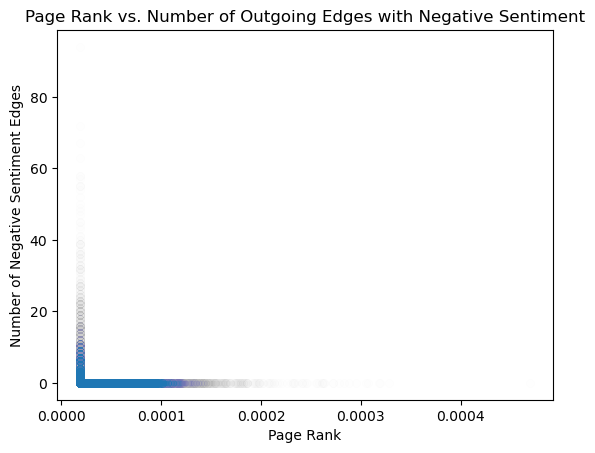

In [25]:
import matplotlib.pyplot as plt

# Calculate PageRank
PRankH = snap.TIntFltH()
snap.GetPageRank(G, PRankH)

# Collect data for visualization
node_ids = []
page_ranks = []
num_negative_sentiments = []

for node in G.Nodes():
    node_id = node.GetId()

    # Get PageRank
    page_rank = PRankH[node_id]
    
    # Initialize counter for outgoing negative sentiments
    num_negative_edges = 0

    # Iterate over outgoing edges
    for out_edge in node.GetOutEdges():
        try:
            sentiment = G.GetIntAttrDatE(G.GetEId(node_id, out_edge), "sentiment")
            if sentiment == 1:  # Assuming 1 corresponds to negative sentiment
                num_negative_edges += 1
        except RuntimeError:
            # No sentiment attribute found for this edge
            pass

    node_ids.append(node_id)
    page_ranks.append(page_rank)
    num_negative_sentiments.append(num_negative_edges)

    # Print details for each node
    print(f"Node {node_id}: Page Rank {page_rank}, Outgoing Negative Sentiments {num_negative_edges}")

# Plotting
plt.scatter(page_ranks, num_negative_sentiments, alpha=0.005)
plt.title('Page Rank vs. Number of Outgoing Edges with Negative Sentiment')
plt.xlabel('Page Rank')
plt.ylabel('Number of Negative Sentiment Edges')
plt.show()

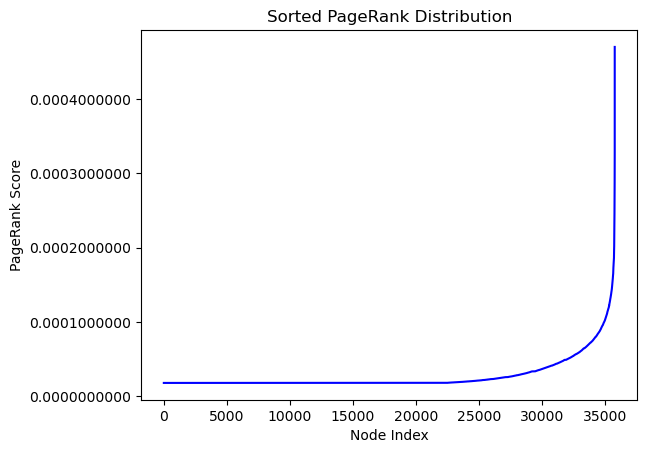

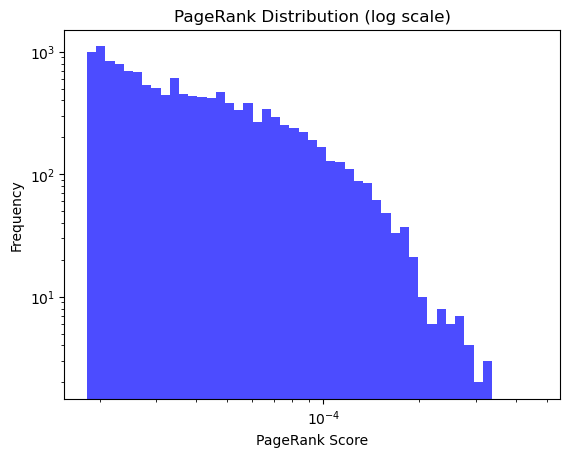

In [29]:
import matplotlib.pyplot as plt
import numpy as np

# Calculate PageRank
PRankH = snap.TIntFltH()
snap.GetPageRank(G, PRankH)

# Collect PageRank values for all nodes
page_ranks = [PRankH[node.GetId()] for node in G.Nodes()]

# Plotting the histogram on a logarithmic scale
plt.hist(page_ranks, bins=np.logspace(np.log10(min(page_ranks)), np.log10(max(page_ranks)), 50), log=True, color='blue', alpha=0.7)
plt.xscale('log')
plt.title('PageRank Distribution (log scale)')
plt.xlabel('PageRank Score')
plt.ylabel('Frequency')
plt.show()


Node 0: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 1: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 2: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 3: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 4: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 5: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 6: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 7: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 8: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 9: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 10: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 11: Page Rank 3.368789325947709e-05, Outgoing Negative Sentiments 0
Node 12: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 13: Page Rank 3.368789325947709e-05, Outgoing Negative Sentimen

Node 17417: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 17418: Page Rank 4.658592913768901e-05, Outgoing Negative Sentiments 0
Node 17419: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 17420: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 17421: Page Rank 3.540763137657202e-05, Outgoing Negative Sentiments 0
Node 17422: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 17423: Page Rank 3.81592123639239e-05, Outgoing Negative Sentiments 0
Node 17424: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 17425: Page Rank 6.950758146982564e-05, Outgoing Negative Sentiments 0
Node 17426: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 17427: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 17428: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 17429: Page Rank 2.9818482496013515e-05, Outgoing Negative Sentiments 0
Node 17430: Page Ran

Node 29584: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 29585: Page Rank 2.227313150725955e-05, Outgoing Negative Sentiments 0
Node 29586: Page Rank 1.8597191281969154e-05, Outgoing Negative Sentiments 0
Node 29587: Page Rank 2.111230827822048e-05, Outgoing Negative Sentiments 0
Node 29588: Page Rank 1.8403720743795978e-05, Outgoing Negative Sentiments 0
Node 29589: Page Rank 1.8597191281969154e-05, Outgoing Negative Sentiments 0
Node 29590: Page Rank 2.0531896663700944e-05, Outgoing Negative Sentiments 0
Node 29591: Page Rank 4.060818558644079e-05, Outgoing Negative Sentiments 0
Node 29592: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 29593: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 29594: Page Rank 0.00012166823560539153, Outgoing Negative Sentiments 0
Node 29595: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 29596: Page Rank 1.82102502056228e-05, Outgoing Negative Sentiments 0
Node 29597: 

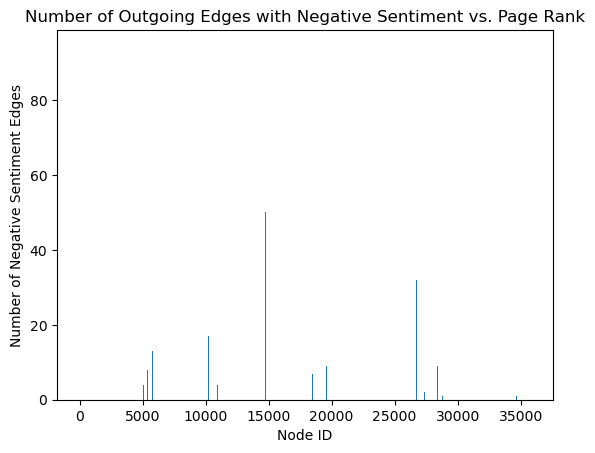

In [33]:
import matplotlib.pyplot as plt

# Calculate PageRank
PRankH = snap.TIntFltH()
snap.GetPageRank(G, PRankH)

# Collect data for visualization
node_ids = []
page_ranks = []
num_negative_sentiments = []

for node in G.Nodes():
    node_id = node.GetId()

    # Get PageRank
    page_rank = PRankH[node_id]
    
    # Initialize counter for outgoing negative sentiments
    num_negative_edges = 0

    # Iterate over outgoing edges
    for out_edge in node.GetOutEdges():
        try:
            sentiment = G.GetIntAttrDatE(G.GetEId(node_id, out_edge), "sentiment")
            if sentiment == 1:  # Assuming 1 corresponds to negative sentiment
                num_negative_edges += 1
        except RuntimeError:
            # No sentiment attribute found for this edge
            pass

    node_ids.append(node_id)
    page_ranks.append(page_rank)
    num_negative_sentiments.append(num_negative_edges)

    # Print details for each node
    print(f"Node {node_id}: Page Rank {page_rank}, Outgoing Negative Sentiments {num_negative_edges}")

# Plotting a bar plot
plt.bar(node_ids, num_negative_sentiments)
plt.title('Number of Outgoing Edges with Negative Sentiment vs. Page Rank')
plt.xlabel('Node ID')
plt.ylabel('Number of Negative Sentiment Edges')
plt.show()


Edge 0: Edge Betweenness 2.0, Sentiment 0
Edge 1: Edge Betweenness 2.0, Sentiment 0
Edge 2: Edge Betweenness 2.0, Sentiment 0
Edge 3: Edge Betweenness 2.0, Sentiment 0
Edge 4: Edge Betweenness 2.0, Sentiment 0
Edge 5: Edge Betweenness 2.0, Sentiment 0
Edge 6: Edge Betweenness 2.0, Sentiment 0
Edge 7: Edge Betweenness 2.0, Sentiment 0
Edge 8: Edge Betweenness 4.0, Sentiment 0
Edge 9: Edge Betweenness 4.0, Sentiment 0
Edge 10: Edge Betweenness 4.0, Sentiment 0
Edge 11: Edge Betweenness 4.0, Sentiment 0
Edge 12: Edge Betweenness 4.0, Sentiment 0
Edge 13: Edge Betweenness 4.0, Sentiment 0
Edge 14: Edge Betweenness 4.0, Sentiment 0
Edge 15: Edge Betweenness 2.0, Sentiment 0
Edge 16: Edge Betweenness 2.0, Sentiment 0
Edge 17: Edge Betweenness 2.0, Sentiment 0
Edge 18: Edge Betweenness 2.0, Sentiment 0
Edge 19: Edge Betweenness 2.0, Sentiment 0
Edge 20: Edge Betweenness 2.0, Sentiment 0
Edge 21: Edge Betweenness 2.0, Sentiment 0
Edge 22: Edge Betweenness 2.0, Sentiment 0
Edge 23: Edge Between

Edge 3843: Edge Betweenness 360.0, Sentiment 0
Edge 3844: Edge Betweenness 360.0, Sentiment 0
Edge 3845: Edge Betweenness 360.0, Sentiment 0
Edge 3846: Edge Betweenness 360.0, Sentiment 0
Edge 3847: Edge Betweenness 336.0, Sentiment 0
Edge 3848: Edge Betweenness 336.0, Sentiment 0
Edge 3849: Edge Betweenness 308.0, Sentiment 0
Edge 3850: Edge Betweenness 308.0, Sentiment 0
Edge 3851: Edge Betweenness 308.0, Sentiment 0
Edge 3852: Edge Betweenness 308.0, Sentiment 0
Edge 3853: Edge Betweenness 56.0, Sentiment 0
Edge 3854: Edge Betweenness 56.0, Sentiment 0
Edge 3855: Edge Betweenness 56.0, Sentiment 0
Edge 3856: Edge Betweenness 56.0, Sentiment 0
Edge 3857: Edge Betweenness 56.0, Sentiment 0
Edge 3858: Edge Betweenness 56.000000000000014, Sentiment 0
Edge 3859: Edge Betweenness 56.000000000000014, Sentiment 0
Edge 3860: Edge Betweenness 56.000000000000014, Sentiment 0
Edge 3861: Edge Betweenness 56.000000000000014, Sentiment 0
Edge 3862: Edge Betweenness 56.000000000000014, Sentiment 0


Edge 6831: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6832: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6833: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6834: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6835: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6836: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6837: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6838: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6839: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6840: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6841: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6842: Edge Betweenness 65.99999999999952, Sentiment 0
Edge 6843: Edge Betweenness 66.00000000000017, Sentiment 0
Edge 6844: Edge Betweenness 66.00000000000017, Sentiment 0
Edge 6845: Edge Betweenness 66.00000000000017, Sentiment 0
Edge 6846: Edge Betweenness 66.00000000000017, Sentiment 0
Edge 6847: Edge Betweenness 66.00000000000017, Sentiment

Edge 9649: Edge Betweenness 21.99999999999998, Sentiment 0
Edge 9650: Edge Betweenness 21.99999999999998, Sentiment 0
Edge 9651: Edge Betweenness 21.99999999999998, Sentiment 0
Edge 9652: Edge Betweenness 70.0, Sentiment 0
Edge 9653: Edge Betweenness 70.0, Sentiment 0
Edge 9654: Edge Betweenness 70.0, Sentiment 0
Edge 9655: Edge Betweenness 70.0, Sentiment 0
Edge 9656: Edge Betweenness 64.0, Sentiment 0
Edge 9657: Edge Betweenness 64.0, Sentiment 0
Edge 9658: Edge Betweenness 64.0, Sentiment 0
Edge 9659: Edge Betweenness 64.0, Sentiment 0
Edge 9660: Edge Betweenness 64.0, Sentiment 0
Edge 9661: Edge Betweenness 64.0, Sentiment 0
Edge 9662: Edge Betweenness 64.0, Sentiment 0
Edge 9663: Edge Betweenness 64.0, Sentiment 0
Edge 9664: Edge Betweenness 54.0, Sentiment 0
Edge 9665: Edge Betweenness 54.0, Sentiment 0
Edge 9666: Edge Betweenness 54.0, Sentiment 0
Edge 9667: Edge Betweenness 22.000000000000004, Sentiment 0
Edge 9668: Edge Betweenness 22.000000000000004, Sentiment 0
Edge 9669: Ed

Edge 12642: Edge Betweenness 74.0, Sentiment 0
Edge 12643: Edge Betweenness 74.0, Sentiment 0
Edge 12644: Edge Betweenness 73.99999999999999, Sentiment 0
Edge 12645: Edge Betweenness 433.99999999999847, Sentiment 0
Edge 12646: Edge Betweenness 433.99999999999847, Sentiment 0
Edge 12647: Edge Betweenness 433.99999999999847, Sentiment 0
Edge 12648: Edge Betweenness 73.99999999999999, Sentiment 0
Edge 12649: Edge Betweenness 73.99999999999999, Sentiment 0
Edge 12650: Edge Betweenness 73.99999999999999, Sentiment 0
Edge 12651: Edge Betweenness 73.99999999999999, Sentiment 0
Edge 12652: Edge Betweenness 73.99999999999997, Sentiment 0
Edge 12653: Edge Betweenness 73.99999999999997, Sentiment 0
Edge 12654: Edge Betweenness 73.99999999999997, Sentiment 0
Edge 12655: Edge Betweenness 560.0, Sentiment 0
Edge 12656: Edge Betweenness 560.0, Sentiment 0
Edge 12657: Edge Betweenness 594.0000000000055, Sentiment 0
Edge 12658: Edge Betweenness 594.0000000000055, Sentiment 0
Edge 12659: Edge Betweennes

Edge 15370: Edge Betweenness 138.0, Sentiment 0
Edge 15371: Edge Betweenness 138.0, Sentiment 0
Edge 15372: Edge Betweenness 138.0, Sentiment 0
Edge 15373: Edge Betweenness 50.0000000000003, Sentiment 0
Edge 15374: Edge Betweenness 50.0000000000003, Sentiment 0
Edge 15375: Edge Betweenness 50.0000000000003, Sentiment 0
Edge 15376: Edge Betweenness 50.0000000000003, Sentiment 0
Edge 15377: Edge Betweenness 50.0000000000003, Sentiment 0
Edge 15378: Edge Betweenness 50.0000000000003, Sentiment 0
Edge 15379: Edge Betweenness 50.0000000000003, Sentiment 0
Edge 15380: Edge Betweenness 50.0000000000003, Sentiment 0
Edge 15381: Edge Betweenness 50.0000000000003, Sentiment 0
Edge 15382: Edge Betweenness 50.0000000000003, Sentiment 0
Edge 15383: Edge Betweenness 209.99999999999815, Sentiment 0
Edge 15384: Edge Betweenness 209.99999999999815, Sentiment 0
Edge 15385: Edge Betweenness 209.99999999999815, Sentiment 0
Edge 15386: Edge Betweenness 209.99999999999815, Sentiment 0
Edge 15387: Edge Betwe

Edge 18247: Edge Betweenness 29.999999999999947, Sentiment 0
Edge 18248: Edge Betweenness 29.999999999999947, Sentiment 0
Edge 18249: Edge Betweenness 55.9999999999999, Sentiment 0
Edge 18250: Edge Betweenness 55.9999999999999, Sentiment 0
Edge 18251: Edge Betweenness 55.9999999999999, Sentiment 0
Edge 18252: Edge Betweenness 55.9999999999999, Sentiment 0
Edge 18253: Edge Betweenness 55.9999999999999, Sentiment 0
Edge 18254: Edge Betweenness 55.9999999999999, Sentiment 0
Edge 18255: Edge Betweenness 55.9999999999999, Sentiment 0
Edge 18256: Edge Betweenness 78.00000000000001, Sentiment 0
Edge 18257: Edge Betweenness 78.00000000000001, Sentiment 0
Edge 18258: Edge Betweenness 78.00000000000001, Sentiment 0
Edge 18259: Edge Betweenness 78.00000000000001, Sentiment 0
Edge 18260: Edge Betweenness 78.00000000000001, Sentiment 0
Edge 18261: Edge Betweenness 78.00000000000001, Sentiment 0
Edge 18262: Edge Betweenness 78.00000000000001, Sentiment 0
Edge 18263: Edge Betweenness 78.0000000000000

Edge 20013: Edge Betweenness 22.0, Sentiment 0
Edge 20014: Edge Betweenness 22.0, Sentiment 0
Edge 20015: Edge Betweenness 22.0, Sentiment 0
Edge 20016: Edge Betweenness 22.0, Sentiment 0
Edge 20017: Edge Betweenness 22.0, Sentiment 0
Edge 20018: Edge Betweenness 22.0, Sentiment 0
Edge 20019: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20020: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20021: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20022: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20023: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20024: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20025: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20026: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20027: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20028: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20029: Edge Betweenness 54.00000000000004, Sentiment 0
Edge 20030: Edge Betweenness 22.000000000000004, Sentiment

Edge 22889: Edge Betweenness 41.99999999999997, Sentiment 0
Edge 22890: Edge Betweenness 41.99999999999997, Sentiment 0
Edge 22891: Edge Betweenness 41.99999999999997, Sentiment 0
Edge 22892: Edge Betweenness 41.99999999999997, Sentiment 0
Edge 22893: Edge Betweenness 41.99999999999997, Sentiment 0
Edge 22894: Edge Betweenness 41.99999999999997, Sentiment 0
Edge 22895: Edge Betweenness 41.99999999999997, Sentiment 0
Edge 22896: Edge Betweenness 42.0, Sentiment 0
Edge 22897: Edge Betweenness 42.0, Sentiment 0
Edge 22898: Edge Betweenness 42.0, Sentiment 0
Edge 22899: Edge Betweenness 42.0, Sentiment 0
Edge 22900: Edge Betweenness 80.00000000000011, Sentiment 0
Edge 22901: Edge Betweenness 80.00000000000011, Sentiment 0
Edge 22902: Edge Betweenness 80.00000000000011, Sentiment 0
Edge 22903: Edge Betweenness 80.00000000000011, Sentiment 0
Edge 22904: Edge Betweenness 80.00000000000011, Sentiment 0
Edge 22905: Edge Betweenness 80.00000000000011, Sentiment 0
Edge 22906: Edge Betweenness 80.

Edge 25286: Edge Betweenness 76.00000000000108, Sentiment 0
Edge 25287: Edge Betweenness 76.00000000000108, Sentiment 0
Edge 25288: Edge Betweenness 76.00000000000108, Sentiment 0
Edge 25289: Edge Betweenness 76.00000000000108, Sentiment 0
Edge 25290: Edge Betweenness 76.00000000000108, Sentiment 0
Edge 25291: Edge Betweenness 76.00000000000007, Sentiment 0
Edge 25292: Edge Betweenness 76.00000000000004, Sentiment 0
Edge 25293: Edge Betweenness 76.00000000000004, Sentiment 0
Edge 25294: Edge Betweenness 76.00000000000004, Sentiment 0
Edge 25295: Edge Betweenness 339.9999999999998, Sentiment 0
Edge 25296: Edge Betweenness 339.9999999999998, Sentiment 0
Edge 25297: Edge Betweenness 339.9999999999998, Sentiment 0
Edge 25298: Edge Betweenness 339.9999999999998, Sentiment 0
Edge 25299: Edge Betweenness 339.9999999999998, Sentiment 0
Edge 25300: Edge Betweenness 339.9999999999998, Sentiment 0
Edge 25301: Edge Betweenness 339.9999999999998, Sentiment 0
Edge 25302: Edge Betweenness 339.9999999

Edge 27610: Edge Betweenness 44.000000000000426, Sentiment 0
Edge 27611: Edge Betweenness 44.000000000000426, Sentiment 0
Edge 27612: Edge Betweenness 44.000000000000426, Sentiment 0
Edge 27613: Edge Betweenness 44.000000000000426, Sentiment 0
Edge 27614: Edge Betweenness 44.000000000000426, Sentiment 0
Edge 27615: Edge Betweenness 43.999999999999986, Sentiment 0
Edge 27616: Edge Betweenness 260.0, Sentiment 0
Edge 27617: Edge Betweenness 260.0, Sentiment 0
Edge 27618: Edge Betweenness 260.0, Sentiment 0
Edge 27619: Edge Betweenness 260.0, Sentiment 0
Edge 27620: Edge Betweenness 260.0, Sentiment 0
Edge 27621: Edge Betweenness 260.0, Sentiment 0
Edge 27622: Edge Betweenness 260.0, Sentiment 0
Edge 27623: Edge Betweenness 260.0, Sentiment 0
Edge 27624: Edge Betweenness 44.0, Sentiment 0
Edge 27625: Edge Betweenness 44.0, Sentiment 0
Edge 27626: Edge Betweenness 44.0, Sentiment 0
Edge 27627: Edge Betweenness 44.0, Sentiment 0
Edge 27628: Edge Betweenness 263.9999999999998, Sentiment 0
Ed

Edge 29544: Edge Betweenness 36.00000000000018, Sentiment 0
Edge 29545: Edge Betweenness 36.0, Sentiment 0
Edge 29546: Edge Betweenness 36.0, Sentiment 0
Edge 29547: Edge Betweenness 36.0, Sentiment 0
Edge 29548: Edge Betweenness 190.51044070014493, Sentiment 0
Edge 29549: Edge Betweenness 190.51044070014493, Sentiment 0
Edge 29550: Edge Betweenness 190.51044070014493, Sentiment 0
Edge 29551: Edge Betweenness 424.4388359216956, Sentiment 0
Edge 29552: Edge Betweenness 424.4388359216956, Sentiment 0
Edge 29553: Edge Betweenness 424.4388359216956, Sentiment 0
Edge 29554: Edge Betweenness 424.4388359216956, Sentiment 0
Edge 29555: Edge Betweenness 424.4388359216956, Sentiment 0
Edge 29556: Edge Betweenness 424.4388359216956, Sentiment 0
Edge 29557: Edge Betweenness 424.4388359216956, Sentiment 0
Edge 29558: Edge Betweenness 424.4388359216956, Sentiment 0
Edge 29559: Edge Betweenness 424.4388359216956, Sentiment 0
Edge 29560: Edge Betweenness 424.4388359216956, Sentiment 0
Edge 29561: Edge

Edge 31386: Edge Betweenness 640.0, Sentiment 0
Edge 31387: Edge Betweenness 640.0, Sentiment 0
Edge 31388: Edge Betweenness 640.0, Sentiment 0
Edge 31389: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31390: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31391: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31392: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31393: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31394: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31395: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31396: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31397: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31398: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31399: Edge Betweenness 70.00000000000038, Sentiment 0
Edge 31400: Edge Betweenness 70.0, Sentiment 0
Edge 31401: Edge Betweenness 70.0, Sentiment 0
Edge 31402: Edge Betweenness 70.0, Sentiment 0
Edge 31403: Edge Betweenness 70.0, Sentiment 0
Edge 314

Edge 32956: Edge Betweenness 56.00000000000013, Sentiment 0
Edge 32957: Edge Betweenness 285.47025007290637, Sentiment 0
Edge 32958: Edge Betweenness 285.47025007290637, Sentiment 0
Edge 32959: Edge Betweenness 285.47025007290637, Sentiment 0
Edge 32960: Edge Betweenness 55.999999999999986, Sentiment 0
Edge 32961: Edge Betweenness 55.999999999999986, Sentiment 0
Edge 32962: Edge Betweenness 337.47025007290574, Sentiment 0
Edge 32963: Edge Betweenness 337.47025007290574, Sentiment 0
Edge 32964: Edge Betweenness 337.47025007290574, Sentiment 0
Edge 32965: Edge Betweenness 56.00000000000048, Sentiment 0
Edge 32966: Edge Betweenness 56.00000000000048, Sentiment 0
Edge 32967: Edge Betweenness 56.00000000000048, Sentiment 0
Edge 32968: Edge Betweenness 56.00000000000048, Sentiment 0
Edge 32969: Edge Betweenness 56.00000000000048, Sentiment 0
Edge 32970: Edge Betweenness 56.00000000000048, Sentiment 0
Edge 32971: Edge Betweenness 56.00000000000048, Sentiment 0
Edge 32972: Edge Betweenness 56.

Edge 34309: Edge Betweenness nan, Sentiment 0
Edge 34310: Edge Betweenness nan, Sentiment 0
Edge 34311: Edge Betweenness nan, Sentiment 0
Edge 34312: Edge Betweenness nan, Sentiment 0
Edge 34313: Edge Betweenness nan, Sentiment 0
Edge 34314: Edge Betweenness nan, Sentiment 0
Edge 34315: Edge Betweenness nan, Sentiment 0
Edge 34316: Edge Betweenness nan, Sentiment 0
Edge 34317: Edge Betweenness nan, Sentiment 0
Edge 34318: Edge Betweenness nan, Sentiment 0
Edge 34319: Edge Betweenness nan, Sentiment 0
Edge 34320: Edge Betweenness nan, Sentiment 0
Edge 34321: Edge Betweenness nan, Sentiment 0
Edge 34322: Edge Betweenness nan, Sentiment 0
Edge 34323: Edge Betweenness nan, Sentiment 0
Edge 34324: Edge Betweenness nan, Sentiment 0
Edge 34325: Edge Betweenness nan, Sentiment 0
Edge 34326: Edge Betweenness nan, Sentiment 0
Edge 34327: Edge Betweenness nan, Sentiment 0
Edge 34328: Edge Betweenness nan, Sentiment 0
Edge 34329: Edge Betweenness nan, Sentiment 0
Edge 34330: Edge Betweenness nan, 

Edge 35939: Edge Betweenness 41.999999999999986, Sentiment 0
Edge 35940: Edge Betweenness 41.999999999999986, Sentiment 0
Edge 35941: Edge Betweenness 41.999999999999986, Sentiment 0
Edge 35942: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35943: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35944: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35945: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35946: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35947: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35948: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35949: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35950: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35951: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35952: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35953: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35954: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 35955: Edge Betweenness 17.99999

Edge 37399: Edge Betweenness 4.0000000000000036, Sentiment 0
Edge 37400: Edge Betweenness 4.0000000000000036, Sentiment 0
Edge 37401: Edge Betweenness 4.0, Sentiment 0
Edge 37402: Edge Betweenness 4.0, Sentiment 0
Edge 37403: Edge Betweenness 6.0, Sentiment 0
Edge 37404: Edge Betweenness 6.0, Sentiment 0
Edge 37405: Edge Betweenness 6.0, Sentiment 0
Edge 37406: Edge Betweenness 6.0, Sentiment 0
Edge 37407: Edge Betweenness 6.0, Sentiment 0
Edge 37408: Edge Betweenness 6.0, Sentiment 0
Edge 37409: Edge Betweenness 6.0, Sentiment 0
Edge 37410: Edge Betweenness 52.0000000000001, Sentiment 0
Edge 37411: Edge Betweenness 52.0000000000001, Sentiment 0
Edge 37412: Edge Betweenness 52.0000000000001, Sentiment 0
Edge 37413: Edge Betweenness 99.99999999999997, Sentiment 0
Edge 37414: Edge Betweenness 51.99999999999971, Sentiment 0
Edge 37415: Edge Betweenness 51.99999999999971, Sentiment 0
Edge 37416: Edge Betweenness 51.99999999999971, Sentiment 0
Edge 37417: Edge Betweenness 51.99999999999971,

Edge 39014: Edge Betweenness 76.0, Sentiment 0
Edge 39015: Edge Betweenness 76.0, Sentiment 0
Edge 39016: Edge Betweenness 76.0, Sentiment 0
Edge 39017: Edge Betweenness 76.0, Sentiment 0
Edge 39018: Edge Betweenness -824.376873244338, Sentiment 0
Edge 39019: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39020: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39021: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39022: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39023: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39024: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39025: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39026: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39027: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39028: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39029: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39030: Edge Betweenness -868.3768732443184, Sentiment 0
Edge 39031: Edge Bet

Edge 40351: Edge Betweenness -54825260175.78438, Sentiment 0
Edge 40352: Edge Betweenness -54825260175.78438, Sentiment 0
Edge 40353: Edge Betweenness -54825045155.46397, Sentiment 0
Edge 40354: Edge Betweenness -54806565763.52, Sentiment 0
Edge 40355: Edge Betweenness -54806565763.52, Sentiment 0
Edge 40356: Edge Betweenness -54806565763.52, Sentiment 0
Edge 40357: Edge Betweenness -54806565763.52, Sentiment 0
Edge 40358: Edge Betweenness 214753.4604329961, Sentiment 0
Edge 40359: Edge Betweenness 214753.4604329961, Sentiment 0
Edge 40360: Edge Betweenness 214753.4604329961, Sentiment 0
Edge 40361: Edge Betweenness 214753.4604329961, Sentiment 0
Edge 40362: Edge Betweenness 1032287.5918800631, Sentiment 0
Edge 40363: Edge Betweenness 1032287.5918800631, Sentiment 0
Edge 40364: Edge Betweenness 1032287.5918800631, Sentiment 0
Edge 40365: Edge Betweenness 1032287.5918800631, Sentiment 0
Edge 40366: Edge Betweenness 1032287.5918800631, Sentiment 0
Edge 40367: Edge Betweenness 1032287.591

Edge 41569: Edge Betweenness nan, Sentiment 0
Edge 41570: Edge Betweenness nan, Sentiment 0
Edge 41571: Edge Betweenness nan, Sentiment 0
Edge 41572: Edge Betweenness nan, Sentiment 0
Edge 41573: Edge Betweenness -1.1247760954298595e+21, Sentiment 0
Edge 41574: Edge Betweenness -1.1247760954298595e+21, Sentiment 0
Edge 41575: Edge Betweenness -1.1247760954298595e+21, Sentiment 0
Edge 41576: Edge Betweenness -1.1247760954298595e+21, Sentiment 0
Edge 41577: Edge Betweenness -1.1247760954298595e+21, Sentiment 0
Edge 41578: Edge Betweenness -1.1247760954298595e+21, Sentiment 0
Edge 41579: Edge Betweenness -1.1247760954298595e+21, Sentiment 0
Edge 41580: Edge Betweenness -1.1247760954298595e+21, Sentiment 0
Edge 41581: Edge Betweenness nan, Sentiment 0
Edge 41582: Edge Betweenness 3.944523727502712e+20, Sentiment 0
Edge 41583: Edge Betweenness 3.944523727502712e+20, Sentiment 0
Edge 41584: Edge Betweenness 3.944523727502712e+20, Sentiment 0
Edge 41585: Edge Betweenness 3.944523727502712e+20

Edge 43040: Edge Betweenness nan, Sentiment 0
Edge 43041: Edge Betweenness nan, Sentiment 0
Edge 43042: Edge Betweenness nan, Sentiment 0
Edge 43043: Edge Betweenness nan, Sentiment 0
Edge 43044: Edge Betweenness nan, Sentiment 0
Edge 43045: Edge Betweenness nan, Sentiment 0
Edge 43046: Edge Betweenness nan, Sentiment 0
Edge 43047: Edge Betweenness nan, Sentiment 0
Edge 43048: Edge Betweenness nan, Sentiment 0
Edge 43049: Edge Betweenness nan, Sentiment 0
Edge 43050: Edge Betweenness nan, Sentiment 0
Edge 43051: Edge Betweenness nan, Sentiment 0
Edge 43052: Edge Betweenness nan, Sentiment 0
Edge 43053: Edge Betweenness nan, Sentiment 0
Edge 43054: Edge Betweenness nan, Sentiment 0
Edge 43055: Edge Betweenness nan, Sentiment 0
Edge 43056: Edge Betweenness nan, Sentiment 0
Edge 43057: Edge Betweenness nan, Sentiment 0
Edge 43058: Edge Betweenness nan, Sentiment 0
Edge 43059: Edge Betweenness nan, Sentiment 0
Edge 43060: Edge Betweenness nan, Sentiment 0
Edge 43061: Edge Betweenness nan, 

Edge 44605: Edge Betweenness 61.457081601853865, Sentiment 0
Edge 44606: Edge Betweenness 61.457081601853865, Sentiment 0
Edge 44607: Edge Betweenness 61.457081601853865, Sentiment 0
Edge 44608: Edge Betweenness 76.05477796316046, Sentiment 0
Edge 44609: Edge Betweenness 118.68568268280713, Sentiment 0
Edge 44610: Edge Betweenness 118.68568268280713, Sentiment 0
Edge 44611: Edge Betweenness 118.68568268280713, Sentiment 0
Edge 44612: Edge Betweenness 118.68568268280713, Sentiment 0
Edge 44613: Edge Betweenness 118.68568268280713, Sentiment 0
Edge 44614: Edge Betweenness 118.68568268280713, Sentiment 0
Edge 44615: Edge Betweenness 118.68568268280713, Sentiment 0
Edge 44616: Edge Betweenness 118.68568268280713, Sentiment 0
Edge 44617: Edge Betweenness 118.68568268280713, Sentiment 0
Edge 44618: Edge Betweenness 118.68568268280713, Sentiment 0
Edge 44619: Edge Betweenness -2574.069046768888, Sentiment 0
Edge 44620: Edge Betweenness 80.0, Sentiment 0
Edge 44621: Edge Betweenness 80.0, Sent

Edge 46113: Edge Betweenness 36882449387105.8, Sentiment 0
Edge 46114: Edge Betweenness 36882449387105.8, Sentiment 0
Edge 46115: Edge Betweenness 36882449387105.8, Sentiment 0
Edge 46116: Edge Betweenness -434.5206853431287, Sentiment 0
Edge 46117: Edge Betweenness -434.5206853431287, Sentiment 0
Edge 46118: Edge Betweenness -434.5206853431287, Sentiment 0
Edge 46119: Edge Betweenness -434.5206853431287, Sentiment 0
Edge 46120: Edge Betweenness -434.5206853431287, Sentiment 0
Edge 46121: Edge Betweenness -215.95243186283642, Sentiment 0
Edge 46122: Edge Betweenness -215.95243186283642, Sentiment 0
Edge 46123: Edge Betweenness -215.95243186283642, Sentiment 0
Edge 46124: Edge Betweenness -215.95243186283642, Sentiment 0
Edge 46125: Edge Betweenness -215.95243186283642, Sentiment 0
Edge 46126: Edge Betweenness -215.95243186283642, Sentiment 0
Edge 46127: Edge Betweenness -215.95243186283642, Sentiment 0
Edge 46128: Edge Betweenness -215.95243186283642, Sentiment 0
Edge 46129: Edge Betwe

Edge 47697: Edge Betweenness 25.999999999999975, Sentiment 0
Edge 47698: Edge Betweenness 25.999999999999975, Sentiment 0
Edge 47699: Edge Betweenness 25.999999999999975, Sentiment 0
Edge 47700: Edge Betweenness 25.999999999999975, Sentiment 0
Edge 47701: Edge Betweenness 25.999999999999975, Sentiment 0
Edge 47702: Edge Betweenness 25.999999999999993, Sentiment 0
Edge 47703: Edge Betweenness 25.999999999999993, Sentiment 0
Edge 47704: Edge Betweenness 98.0, Sentiment 0
Edge 47705: Edge Betweenness 98.0, Sentiment 0
Edge 47706: Edge Betweenness 95.99999999999976, Sentiment 0
Edge 47707: Edge Betweenness 95.99999999999976, Sentiment 0
Edge 47708: Edge Betweenness 95.99999999999976, Sentiment 0
Edge 47709: Edge Betweenness 95.99999999999976, Sentiment 0
Edge 47710: Edge Betweenness 95.99999999999976, Sentiment 0
Edge 47711: Edge Betweenness 95.99999999999976, Sentiment 0
Edge 47712: Edge Betweenness 95.99999999999976, Sentiment 0
Edge 47713: Edge Betweenness 95.99999999999976, Sentiment 0

Edge 49520: Edge Betweenness 9376438480.085068, Sentiment 0
Edge 49521: Edge Betweenness 9376438480.085068, Sentiment 0
Edge 49522: Edge Betweenness 9376438480.085068, Sentiment 0
Edge 49523: Edge Betweenness 9376438480.085068, Sentiment 0
Edge 49524: Edge Betweenness 9376438480.085068, Sentiment 0
Edge 49525: Edge Betweenness 9376438480.085068, Sentiment 0
Edge 49526: Edge Betweenness 9279078295.452862, Sentiment 0
Edge 49527: Edge Betweenness 36844.966266915166, Sentiment 0
Edge 49528: Edge Betweenness 36844.966266915166, Sentiment 0
Edge 49529: Edge Betweenness -340737.3329020669, Sentiment 0
Edge 49530: Edge Betweenness -340737.3329020669, Sentiment 0
Edge 49531: Edge Betweenness -340737.3329020669, Sentiment 0
Edge 49532: Edge Betweenness -340737.3329020669, Sentiment 0
Edge 49533: Edge Betweenness -340737.3329020669, Sentiment 0
Edge 49534: Edge Betweenness -340737.3329020669, Sentiment 0
Edge 49535: Edge Betweenness 9279390960.445486, Sentiment 0
Edge 49536: Edge Betweenness 927

Edge 50821: Edge Betweenness -41459.1561371486, Sentiment 0
Edge 50822: Edge Betweenness -41459.1561371486, Sentiment 0
Edge 50823: Edge Betweenness -51890885245.80862, Sentiment 0
Edge 50824: Edge Betweenness -51890885245.80862, Sentiment 0
Edge 50825: Edge Betweenness -51890885245.80862, Sentiment 0
Edge 50826: Edge Betweenness -51890885245.80862, Sentiment 0
Edge 50827: Edge Betweenness -51890885245.80862, Sentiment 0
Edge 50828: Edge Betweenness -51890885245.80862, Sentiment 0
Edge 50829: Edge Betweenness -51890885245.80862, Sentiment 0
Edge 50830: Edge Betweenness 51126.74853836926, Sentiment 0
Edge 50831: Edge Betweenness 51126.74853836926, Sentiment 0
Edge 50832: Edge Betweenness 51126.74853836926, Sentiment 0
Edge 50833: Edge Betweenness -51685974260.934235, Sentiment 0
Edge 50834: Edge Betweenness -51685963851.67068, Sentiment 0
Edge 50835: Edge Betweenness -51685953446.40712, Sentiment 0
Edge 50836: Edge Betweenness -51685953446.40712, Sentiment 0
Edge 50837: Edge Betweenness

Edge 52379: Edge Betweenness 74.0, Sentiment 0
Edge 52380: Edge Betweenness 650.0, Sentiment 0
Edge 52381: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52382: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52383: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52384: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52385: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52386: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52387: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52388: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52389: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52390: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52391: Edge Betweenness 624.0000000000006, Sentiment 0
Edge 52392: Edge Betweenness 594.000000000008, Sentiment 0
Edge 52393: Edge Betweenness 594.000000000008, Sentiment 0
Edge 52394: Edge Betweenness 594.000000000008, Sentiment 0
Edge 52395: Edge Betweenness 594.000000000008, Sentiment 0
Edge 5239

Edge 54046: Edge Betweenness 1584.3586649344577, Sentiment 0
Edge 54047: Edge Betweenness 1584.3586649344577, Sentiment 0
Edge 54048: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54049: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54050: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54051: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54052: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54053: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54054: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54055: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54056: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54057: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54058: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54059: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54060: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54061: Edge Betweenness -2107.0871915518132, Sentiment 0
Edge 54062

Edge 55490: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55491: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55492: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55493: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55494: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55495: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55496: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55497: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55498: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55499: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55500: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55501: Edge Betweenness 111.99999999999982, Sentiment 0
Edge 55502: Edge Betweenness 107.99999999999983, Sentiment 0
Edge 55503: Edge Betweenness 107.99999999999983, Sentiment 0
Edge 55504: Edge Betweenness 107.99999999999983, Sentiment 0
Edge 55505: Edge Betweenness 107.99999999999983, Sentiment 0
Edge 55506: Edge Between

Edge 57137: Edge Betweenness 116.00000000000144, Sentiment 0
Edge 57138: Edge Betweenness 116.00000000000144, Sentiment 0
Edge 57139: Edge Betweenness 116.00000000000144, Sentiment 0
Edge 57140: Edge Betweenness 116.00000000000144, Sentiment 0
Edge 57141: Edge Betweenness 116.00000000000144, Sentiment 0
Edge 57142: Edge Betweenness 116.00000000000144, Sentiment 0
Edge 57143: Edge Betweenness 115.99999999999959, Sentiment 0
Edge 57144: Edge Betweenness 115.99999999999959, Sentiment 0
Edge 57145: Edge Betweenness 115.99999999999959, Sentiment 0
Edge 57146: Edge Betweenness 116.00000000000244, Sentiment 0
Edge 57147: Edge Betweenness 116.00000000000244, Sentiment 0
Edge 57148: Edge Betweenness 116.00000000000244, Sentiment 0
Edge 57149: Edge Betweenness 116.00000000000244, Sentiment 0
Edge 57150: Edge Betweenness 116.00000000000244, Sentiment 0
Edge 57151: Edge Betweenness 116.00000000000244, Sentiment 0
Edge 57152: Edge Betweenness 116.00000000000244, Sentiment 0
Edge 57153: Edge Between

Edge 58655: Edge Betweenness 30.000000000000007, Sentiment 0
Edge 58656: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58657: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58658: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58659: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58660: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58661: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58662: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58663: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58664: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58665: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58666: Edge Betweenness 29.999999999999858, Sentiment 0
Edge 58667: Edge Betweenness 30.000000000000345, Sentiment 0
Edge 58668: Edge Betweenness 30.000000000000345, Sentiment 0
Edge 58669: Edge Betweenness 30.000000000000345, Sentiment 0
Edge 58670: Edge Betweenness 30.000000000000345, Sentiment 0
Edge 58671: Edge Between

Edge 60224: Edge Betweenness 14.000000000000119, Sentiment 0
Edge 60225: Edge Betweenness 14.000000000000119, Sentiment 0
Edge 60226: Edge Betweenness 14.000000000000119, Sentiment 0
Edge 60227: Edge Betweenness 14.000000000000119, Sentiment 0
Edge 60228: Edge Betweenness 14.000000000000119, Sentiment 0
Edge 60229: Edge Betweenness 14.000000000000119, Sentiment 0
Edge 60230: Edge Betweenness 14.000000000000119, Sentiment 0
Edge 60231: Edge Betweenness 14.000000000000119, Sentiment 0
Edge 60232: Edge Betweenness 14.000000000000119, Sentiment 0
Edge 60233: Edge Betweenness 32.0, Sentiment 0
Edge 60234: Edge Betweenness 30.000000000000025, Sentiment 0
Edge 60235: Edge Betweenness 30.000000000000025, Sentiment 0
Edge 60236: Edge Betweenness 30.000000000000025, Sentiment 0
Edge 60237: Edge Betweenness 30.000000000000025, Sentiment 0
Edge 60238: Edge Betweenness 30.000000000000025, Sentiment 0
Edge 60239: Edge Betweenness 30.000000000000025, Sentiment 0
Edge 60240: Edge Betweenness 30.000000

Edge 61737: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61738: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61739: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61740: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61741: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61742: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61743: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61744: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61745: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61746: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61747: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61748: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61749: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61750: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61751: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61752: Edge Betweenness 13.999999999999883, Sentiment 0
Edge 61753: Edge Between

Edge 63459: Edge Betweenness -16135471789.475388, Sentiment 0
Edge 63460: Edge Betweenness -16135471789.475388, Sentiment 0
Edge 63461: Edge Betweenness -16135471789.475388, Sentiment 0
Edge 63462: Edge Betweenness -16135471789.475388, Sentiment 0
Edge 63463: Edge Betweenness -751026700.5152074, Sentiment 0
Edge 63464: Edge Betweenness inf, Sentiment 0
Edge 63465: Edge Betweenness inf, Sentiment 0
Edge 63466: Edge Betweenness inf, Sentiment 0
Edge 63467: Edge Betweenness inf, Sentiment 0
Edge 63468: Edge Betweenness inf, Sentiment 0
Edge 63469: Edge Betweenness inf, Sentiment 0
Edge 63470: Edge Betweenness inf, Sentiment 0
Edge 63471: Edge Betweenness inf, Sentiment 0
Edge 63472: Edge Betweenness inf, Sentiment 0
Edge 63473: Edge Betweenness inf, Sentiment 0
Edge 63474: Edge Betweenness inf, Sentiment 0
Edge 63475: Edge Betweenness inf, Sentiment 0
Edge 63476: Edge Betweenness inf, Sentiment 0
Edge 63477: Edge Betweenness inf, Sentiment 0
Edge 63478: Edge Betweenness inf, Sentiment 0
E

Edge 65244: Edge Betweenness -437545.65741854045, Sentiment 0
Edge 65245: Edge Betweenness -437545.65741854045, Sentiment 0
Edge 65246: Edge Betweenness -437545.65741854045, Sentiment 0
Edge 65247: Edge Betweenness -437545.65741854045, Sentiment 0
Edge 65248: Edge Betweenness -437545.65741854045, Sentiment 0
Edge 65249: Edge Betweenness -437545.65741854045, Sentiment 0
Edge 65250: Edge Betweenness 969.3556987741338, Sentiment 0
Edge 65251: Edge Betweenness -76032.37347807965, Sentiment 0
Edge 65252: Edge Betweenness -76032.37347807965, Sentiment 0
Edge 65253: Edge Betweenness -76032.37347807965, Sentiment 0
Edge 65254: Edge Betweenness -76032.37347807965, Sentiment 0
Edge 65255: Edge Betweenness -76032.37347807965, Sentiment 0
Edge 65256: Edge Betweenness -76032.37347807965, Sentiment 0
Edge 65257: Edge Betweenness -76032.37347807965, Sentiment 0
Edge 65258: Edge Betweenness -76032.37347807965, Sentiment 0
Edge 65259: Edge Betweenness 88747990.9154438, Sentiment 0
Edge 65260: Edge Betw

Edge 66823: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66824: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66825: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66826: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66827: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66828: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66829: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66830: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66831: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66832: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66833: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66834: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66835: Edge Betweenness -135285539227.90279, Sentiment 0
Edge 66836: Edge Betweenness -135762365212.68033, Sentiment 0
Edge 66837: Edge Betweenness -135762365212.68033, Sentiment 0
Edge 66838: Edge Betweenness -135762365212.68033, Sentiment 0
Edge 668

Edge 68188: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68189: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68190: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68191: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68192: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68193: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68194: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68195: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68196: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68197: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68198: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68199: Edge Betweenness 51.999999999999964, Sentiment 0
Edge 68200: Edge Betweenness 51.99999999999994, Sentiment 0
Edge 68201: Edge Betweenness 51.99999999999994, Sentiment 0
Edge 68202: Edge Betweenness 51.99999999999994, Sentiment 0
Edge 68203: Edge Betweenness 51.99999999999994, Sentiment 0
Edge 68204: Edge Betweenness

Edge 69905: Edge Betweenness nan, Sentiment 0
Edge 69906: Edge Betweenness nan, Sentiment 0
Edge 69907: Edge Betweenness nan, Sentiment 0
Edge 69908: Edge Betweenness nan, Sentiment 0
Edge 69909: Edge Betweenness nan, Sentiment 0
Edge 69910: Edge Betweenness nan, Sentiment 0
Edge 69911: Edge Betweenness nan, Sentiment 0
Edge 69912: Edge Betweenness nan, Sentiment 0
Edge 69913: Edge Betweenness nan, Sentiment 0
Edge 69914: Edge Betweenness nan, Sentiment 0
Edge 69915: Edge Betweenness nan, Sentiment 0
Edge 69916: Edge Betweenness nan, Sentiment 0
Edge 69917: Edge Betweenness nan, Sentiment 0
Edge 69918: Edge Betweenness nan, Sentiment 0
Edge 69919: Edge Betweenness nan, Sentiment 0
Edge 69920: Edge Betweenness nan, Sentiment 0
Edge 69921: Edge Betweenness nan, Sentiment 0
Edge 69922: Edge Betweenness nan, Sentiment 0
Edge 69923: Edge Betweenness nan, Sentiment 0
Edge 69924: Edge Betweenness nan, Sentiment 0
Edge 69925: Edge Betweenness nan, Sentiment 0
Edge 69926: Edge Betweenness nan, 

Edge 71812: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71813: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71814: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71815: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71816: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71817: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71818: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71819: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71820: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71821: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71822: Edge Betweenness -210686809040.93137, Sentiment 0
Edge 71823: Edge Betweenness -220279613493.02637, Sentiment 0
Edge 71824: Edge Betweenness -220279613493.02637, Sentiment 0
Edge 71825: Edge Betweenness -220279613493.02637, Sentiment 0
Edge 71826: Edge Betweenness -220279613493.02637, Sentiment 0
Edge 71827: Edge Betweenness -220279613493.02637, Sentiment 0
Edge 718

Edge 73467: Edge Betweenness 153.99999999999832, Sentiment 0
Edge 73468: Edge Betweenness 153.99999999999832, Sentiment 0
Edge 73469: Edge Betweenness 153.99999999999832, Sentiment 0
Edge 73470: Edge Betweenness 153.99999999999832, Sentiment 0
Edge 73471: Edge Betweenness 153.99999999999832, Sentiment 0
Edge 73472: Edge Betweenness 153.99999999999832, Sentiment 0
Edge 73473: Edge Betweenness 143.99999999999997, Sentiment 0
Edge 73474: Edge Betweenness 143.99999999999997, Sentiment 0
Edge 73475: Edge Betweenness 143.99999999999997, Sentiment 0
Edge 73476: Edge Betweenness 143.99999999999997, Sentiment 0
Edge 73477: Edge Betweenness 143.99999999999997, Sentiment 0
Edge 73478: Edge Betweenness 143.99999999999997, Sentiment 0
Edge 73479: Edge Betweenness 143.99999999999997, Sentiment 0
Edge 73480: Edge Betweenness 143.99999999999997, Sentiment 0
Edge 73481: Edge Betweenness 143.99999999999997, Sentiment 0
Edge 73482: Edge Betweenness 143.99999999999997, Sentiment 0
Edge 73483: Edge Between

Edge 75459: Edge Betweenness 24639.479318176996, Sentiment 0
Edge 75460: Edge Betweenness 24639.479318176996, Sentiment 0
Edge 75461: Edge Betweenness 24639.479318176996, Sentiment 0
Edge 75462: Edge Betweenness 24639.479318176996, Sentiment 0
Edge 75463: Edge Betweenness 24639.479318176996, Sentiment 0
Edge 75464: Edge Betweenness 24639.479318176996, Sentiment 0
Edge 75465: Edge Betweenness 1003241056.6652327, Sentiment 0
Edge 75466: Edge Betweenness 1003241056.6652327, Sentiment 0
Edge 75467: Edge Betweenness 1003241056.6652327, Sentiment 0
Edge 75468: Edge Betweenness 1003241056.6652327, Sentiment 0
Edge 75469: Edge Betweenness 1003241056.6652327, Sentiment 0
Edge 75470: Edge Betweenness 1003241056.6652327, Sentiment 0
Edge 75471: Edge Betweenness 830522.005092519, Sentiment 0
Edge 75472: Edge Betweenness 830522.005092519, Sentiment 0
Edge 75473: Edge Betweenness 830522.005092519, Sentiment 0
Edge 75474: Edge Betweenness 830522.005092519, Sentiment 0
Edge 75475: Edge Betweenness 830

Edge 76957: Edge Betweenness -2172.5377219742227, Sentiment 0
Edge 76958: Edge Betweenness -2172.5377219742227, Sentiment 0
Edge 76959: Edge Betweenness -2172.5377219742227, Sentiment 0
Edge 76960: Edge Betweenness -2172.5377219742227, Sentiment 0
Edge 76961: Edge Betweenness -2172.5377219742227, Sentiment 0
Edge 76962: Edge Betweenness -2172.5377219742227, Sentiment 0
Edge 76963: Edge Betweenness 63.99999999999973, Sentiment 0
Edge 76964: Edge Betweenness 63.99999999999973, Sentiment 0
Edge 76965: Edge Betweenness 63.99999999999973, Sentiment 0
Edge 76966: Edge Betweenness 63.99999999999973, Sentiment 0
Edge 76967: Edge Betweenness 63.99999999999973, Sentiment 0
Edge 76968: Edge Betweenness 63.99999999999973, Sentiment 0
Edge 76969: Edge Betweenness -2160.5377219742177, Sentiment 0
Edge 76970: Edge Betweenness -2160.537721974223, Sentiment 0
Edge 76971: Edge Betweenness -2160.537721974223, Sentiment 0
Edge 76972: Edge Betweenness -2160.537721974223, Sentiment 0
Edge 76973: Edge Betwee

Edge 78310: Edge Betweenness 76.0, Sentiment 0
Edge 78311: Edge Betweenness 76.0, Sentiment 0
Edge 78312: Edge Betweenness 76.0, Sentiment 0
Edge 78313: Edge Betweenness 76.0, Sentiment 0
Edge 78314: Edge Betweenness 75.99999999999962, Sentiment 0
Edge 78315: Edge Betweenness 75.99999999999962, Sentiment 0
Edge 78316: Edge Betweenness 75.99999999999962, Sentiment 0
Edge 78317: Edge Betweenness 75.99999999999962, Sentiment 0
Edge 78318: Edge Betweenness 75.99999999999962, Sentiment 0
Edge 78319: Edge Betweenness 75.99999999999962, Sentiment 0
Edge 78320: Edge Betweenness 75.99999999999962, Sentiment 0
Edge 78321: Edge Betweenness 546.8481924565397, Sentiment 0
Edge 78322: Edge Betweenness 546.8481924565397, Sentiment 0
Edge 78323: Edge Betweenness 514.8481924565392, Sentiment 0
Edge 78324: Edge Betweenness 514.8481924565392, Sentiment 0
Edge 78325: Edge Betweenness 514.8481924565392, Sentiment 0
Edge 78326: Edge Betweenness 514.8481924565392, Sentiment 0
Edge 78327: Edge Betweenness 514

Edge 80092: Edge Betweenness 50.000000000000846, Sentiment 0
Edge 80093: Edge Betweenness 50.000000000000846, Sentiment 0
Edge 80094: Edge Betweenness 50.000000000000846, Sentiment 0
Edge 80095: Edge Betweenness 50.000000000000846, Sentiment 0
Edge 80096: Edge Betweenness 50.000000000000846, Sentiment 0
Edge 80097: Edge Betweenness 50.000000000000846, Sentiment 0
Edge 80098: Edge Betweenness 50.00000000000021, Sentiment 0
Edge 80099: Edge Betweenness 50.00000000000021, Sentiment 0
Edge 80100: Edge Betweenness 50.00000000000021, Sentiment 0
Edge 80101: Edge Betweenness 335.99999999999994, Sentiment 0
Edge 80102: Edge Betweenness 335.99999999999994, Sentiment 0
Edge 80103: Edge Betweenness 335.99999999999994, Sentiment 0
Edge 80104: Edge Betweenness 338.00000000000165, Sentiment 0
Edge 80105: Edge Betweenness 338.00000000000165, Sentiment 0
Edge 80106: Edge Betweenness 338.00000000000165, Sentiment 0
Edge 80107: Edge Betweenness 338.00000000000165, Sentiment 0
Edge 80108: Edge Betweennes

Edge 81624: Edge Betweenness nan, Sentiment 0
Edge 81625: Edge Betweenness nan, Sentiment 0
Edge 81626: Edge Betweenness nan, Sentiment 0
Edge 81627: Edge Betweenness nan, Sentiment 0
Edge 81628: Edge Betweenness nan, Sentiment 0
Edge 81629: Edge Betweenness nan, Sentiment 0
Edge 81630: Edge Betweenness nan, Sentiment 0
Edge 81631: Edge Betweenness nan, Sentiment 0
Edge 81632: Edge Betweenness nan, Sentiment 0
Edge 81633: Edge Betweenness nan, Sentiment 0
Edge 81634: Edge Betweenness nan, Sentiment 0
Edge 81635: Edge Betweenness nan, Sentiment 0
Edge 81636: Edge Betweenness nan, Sentiment 0
Edge 81637: Edge Betweenness nan, Sentiment 0
Edge 81638: Edge Betweenness nan, Sentiment 0
Edge 81639: Edge Betweenness nan, Sentiment 0
Edge 81640: Edge Betweenness nan, Sentiment 0
Edge 81641: Edge Betweenness nan, Sentiment 0
Edge 81642: Edge Betweenness nan, Sentiment 0
Edge 81643: Edge Betweenness nan, Sentiment 0
Edge 81644: Edge Betweenness nan, Sentiment 0
Edge 81645: Edge Betweenness nan, 

Edge 83330: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83331: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83332: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83333: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83334: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83335: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83336: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83337: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83338: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83339: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83340: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83341: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83342: Edge Betweenness 168485306.19641587, Sentiment 0
Edge 83343: Edge Betweenness 167216232.56205818, Sentiment 0
Edge 83344: Edge Betweenness 167216232.56205818, Sentiment 0
Edge 83345: Edge Betweenness 167216232.56205818, Sentiment 0
Edge 83346: Edge Between

Edge 85257: Edge Betweenness nan, Sentiment 0
Edge 85258: Edge Betweenness nan, Sentiment 0
Edge 85259: Edge Betweenness nan, Sentiment 0
Edge 85260: Edge Betweenness nan, Sentiment 0
Edge 85261: Edge Betweenness nan, Sentiment 0
Edge 85262: Edge Betweenness nan, Sentiment 0
Edge 85263: Edge Betweenness nan, Sentiment 0
Edge 85264: Edge Betweenness nan, Sentiment 0
Edge 85265: Edge Betweenness nan, Sentiment 0
Edge 85266: Edge Betweenness nan, Sentiment 0
Edge 85267: Edge Betweenness nan, Sentiment 0
Edge 85268: Edge Betweenness nan, Sentiment 0
Edge 85269: Edge Betweenness nan, Sentiment 0
Edge 85270: Edge Betweenness nan, Sentiment 0
Edge 85271: Edge Betweenness nan, Sentiment 0
Edge 85272: Edge Betweenness nan, Sentiment 0
Edge 85273: Edge Betweenness nan, Sentiment 0
Edge 85274: Edge Betweenness nan, Sentiment 0
Edge 85275: Edge Betweenness nan, Sentiment 0
Edge 85276: Edge Betweenness nan, Sentiment 0
Edge 85277: Edge Betweenness nan, Sentiment 0
Edge 85278: Edge Betweenness nan, 

Edge 86962: Edge Betweenness 11.99999999999996, Sentiment 0
Edge 86963: Edge Betweenness 11.99999999999996, Sentiment 0
Edge 86964: Edge Betweenness 11.99999999999996, Sentiment 0
Edge 86965: Edge Betweenness 11.99999999999996, Sentiment 0
Edge 86966: Edge Betweenness 11.99999999999996, Sentiment 0
Edge 86967: Edge Betweenness 11.99999999999996, Sentiment 0
Edge 86968: Edge Betweenness 11.99999999999996, Sentiment 0
Edge 86969: Edge Betweenness 12.0, Sentiment 0
Edge 86970: Edge Betweenness 12.0, Sentiment 0
Edge 86971: Edge Betweenness 12.0, Sentiment 0
Edge 86972: Edge Betweenness 12.0, Sentiment 0
Edge 86973: Edge Betweenness 12.0, Sentiment 0
Edge 86974: Edge Betweenness 12.0, Sentiment 0
Edge 86975: Edge Betweenness 12.0, Sentiment 0
Edge 86976: Edge Betweenness 12.0, Sentiment 0
Edge 86977: Edge Betweenness 12.0, Sentiment 0
Edge 86978: Edge Betweenness 12.0, Sentiment 0
Edge 86979: Edge Betweenness 12.0, Sentiment 0
Edge 86980: Edge Betweenness 12.0, Sentiment 0
Edge 86981: Edge

Edge 88749: Edge Betweenness -228707332330.7717, Sentiment 0
Edge 88750: Edge Betweenness -228707332330.7717, Sentiment 0
Edge 88751: Edge Betweenness -216572989568.037, Sentiment 0
Edge 88752: Edge Betweenness -216572989568.037, Sentiment 0
Edge 88753: Edge Betweenness -216572989568.037, Sentiment 0
Edge 88754: Edge Betweenness -216572989568.037, Sentiment 0
Edge 88755: Edge Betweenness -216572989568.037, Sentiment 0
Edge 88756: Edge Betweenness -216572989568.037, Sentiment 0
Edge 88757: Edge Betweenness -216572989568.037, Sentiment 0
Edge 88758: Edge Betweenness -216572989568.037, Sentiment 0
Edge 88759: Edge Betweenness -213551799889.69492, Sentiment 0
Edge 88760: Edge Betweenness -213551799889.69492, Sentiment 0
Edge 88761: Edge Betweenness -213551799889.69492, Sentiment 0
Edge 88762: Edge Betweenness -213551799889.69492, Sentiment 0
Edge 88763: Edge Betweenness 108.74839401555099, Sentiment 0
Edge 88764: Edge Betweenness -3391296840.1826267, Sentiment 0
Edge 88765: Edge Betweennes

Edge 90608: Edge Betweenness 49.999999999999574, Sentiment 0
Edge 90609: Edge Betweenness 49.999999999999574, Sentiment 0
Edge 90610: Edge Betweenness 49.999999999999574, Sentiment 0
Edge 90611: Edge Betweenness 49.999999999999574, Sentiment 0
Edge 90612: Edge Betweenness 49.999999999999574, Sentiment 0
Edge 90613: Edge Betweenness 49.999999999999574, Sentiment 0
Edge 90614: Edge Betweenness 336.0, Sentiment 0
Edge 90615: Edge Betweenness 336.0, Sentiment 0
Edge 90616: Edge Betweenness 336.0, Sentiment 0
Edge 90617: Edge Betweenness 336.0, Sentiment 0
Edge 90618: Edge Betweenness 50.0, Sentiment 0
Edge 90619: Edge Betweenness 50.0, Sentiment 0
Edge 90620: Edge Betweenness 50.0, Sentiment 0
Edge 90621: Edge Betweenness 50.0, Sentiment 0
Edge 90622: Edge Betweenness 50.0, Sentiment 0
Edge 90623: Edge Betweenness 50.0, Sentiment 0
Edge 90624: Edge Betweenness 50.0, Sentiment 0
Edge 90625: Edge Betweenness 50.0, Sentiment 0
Edge 90626: Edge Betweenness 50.0, Sentiment 0
Edge 90627: Edge Be

Edge 92388: Edge Betweenness -8580416063.300565, Sentiment 0
Edge 92389: Edge Betweenness -8580416063.300565, Sentiment 0
Edge 92390: Edge Betweenness -8580416063.300565, Sentiment 0
Edge 92391: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92392: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92393: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92394: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92395: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92396: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92397: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92398: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92399: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92400: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92401: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92402: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92403: Edge Betweenness 3618.3331974731746, Sentiment 0
Edge 92404: Edge Between

Edge 94352: Edge Betweenness 38.000000000000114, Sentiment 0
Edge 94353: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94354: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94355: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94356: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94357: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94358: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94359: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94360: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94361: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94362: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94363: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94364: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94365: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94366: Edge Betweenness 72.00000000000036, Sentiment 0
Edge 94367: Edge Betweenness 37.99999999999997, Sentiment 0
Edge 94368: Edge Betweenness 37.9999999

Edge 95876: Edge Betweenness nan, Sentiment 0
Edge 95877: Edge Betweenness nan, Sentiment 0
Edge 95878: Edge Betweenness nan, Sentiment 0
Edge 95879: Edge Betweenness nan, Sentiment 0
Edge 95880: Edge Betweenness nan, Sentiment 0
Edge 95881: Edge Betweenness nan, Sentiment 0
Edge 95882: Edge Betweenness nan, Sentiment 0
Edge 95883: Edge Betweenness nan, Sentiment 0
Edge 95884: Edge Betweenness nan, Sentiment 0
Edge 95885: Edge Betweenness nan, Sentiment 0
Edge 95886: Edge Betweenness nan, Sentiment 0
Edge 95887: Edge Betweenness nan, Sentiment 0
Edge 95888: Edge Betweenness nan, Sentiment 0
Edge 95889: Edge Betweenness nan, Sentiment 0
Edge 95890: Edge Betweenness nan, Sentiment 0
Edge 95891: Edge Betweenness nan, Sentiment 0
Edge 95892: Edge Betweenness nan, Sentiment 0
Edge 95893: Edge Betweenness nan, Sentiment 0
Edge 95894: Edge Betweenness nan, Sentiment 0
Edge 95895: Edge Betweenness nan, Sentiment 0
Edge 95896: Edge Betweenness nan, Sentiment 0
Edge 95897: Edge Betweenness nan, 

Edge 97548: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97549: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97550: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97551: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97552: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97553: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97554: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97555: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97556: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97557: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97558: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97559: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97560: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97561: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97562: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97563: Edge Betweenness 47145742370.46173, Sentiment 0
Edge 97564: Edge Betweenness 47145742370

Edge 99233: Edge Betweenness nan, Sentiment 0
Edge 99234: Edge Betweenness nan, Sentiment 0
Edge 99235: Edge Betweenness nan, Sentiment 0
Edge 99236: Edge Betweenness nan, Sentiment 0
Edge 99237: Edge Betweenness nan, Sentiment 0
Edge 99238: Edge Betweenness nan, Sentiment 0
Edge 99239: Edge Betweenness nan, Sentiment 0
Edge 99240: Edge Betweenness nan, Sentiment 0
Edge 99241: Edge Betweenness nan, Sentiment 0
Edge 99242: Edge Betweenness nan, Sentiment 0
Edge 99243: Edge Betweenness nan, Sentiment 0
Edge 99244: Edge Betweenness nan, Sentiment 0
Edge 99245: Edge Betweenness nan, Sentiment 0
Edge 99246: Edge Betweenness nan, Sentiment 0
Edge 99247: Edge Betweenness nan, Sentiment 0
Edge 99248: Edge Betweenness nan, Sentiment 0
Edge 99249: Edge Betweenness nan, Sentiment 0
Edge 99250: Edge Betweenness nan, Sentiment 0
Edge 99251: Edge Betweenness nan, Sentiment 0
Edge 99252: Edge Betweenness nan, Sentiment 0
Edge 99253: Edge Betweenness nan, Sentiment 0
Edge 99254: Edge Betweenness nan, 

Edge 101018: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 101019: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 101020: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 101021: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 101022: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 101023: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 101024: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 101025: Edge Betweenness 18.0, Sentiment 0
Edge 101026: Edge Betweenness 18.0, Sentiment 0
Edge 101027: Edge Betweenness 9.999999999999996, Sentiment 0
Edge 101028: Edge Betweenness 9.999999999999996, Sentiment 0
Edge 101029: Edge Betweenness 9.999999999999996, Sentiment 0
Edge 101030: Edge Betweenness 9.999999999999996, Sentiment 0
Edge 101031: Edge Betweenness 9.999999999999996, Sentiment 0
Edge 101032: Edge Betweenness 9.999999999999996, Sentiment 0
Edge 101033: Edge Betweenness 9.999999999999996, Sentiment 0
Edge 101034: Edge Betweenness 9.999999999999996, S

Edge 102682: Edge Betweenness nan, Sentiment 0
Edge 102683: Edge Betweenness nan, Sentiment 0
Edge 102684: Edge Betweenness nan, Sentiment 0
Edge 102685: Edge Betweenness nan, Sentiment 0
Edge 102686: Edge Betweenness nan, Sentiment 0
Edge 102687: Edge Betweenness nan, Sentiment 0
Edge 102688: Edge Betweenness nan, Sentiment 0
Edge 102689: Edge Betweenness nan, Sentiment 0
Edge 102690: Edge Betweenness nan, Sentiment 0
Edge 102691: Edge Betweenness nan, Sentiment 0
Edge 102692: Edge Betweenness nan, Sentiment 0
Edge 102693: Edge Betweenness nan, Sentiment 0
Edge 102694: Edge Betweenness nan, Sentiment 0
Edge 102695: Edge Betweenness nan, Sentiment 0
Edge 102696: Edge Betweenness nan, Sentiment 0
Edge 102697: Edge Betweenness nan, Sentiment 0
Edge 102698: Edge Betweenness nan, Sentiment 0
Edge 102699: Edge Betweenness nan, Sentiment 0
Edge 102700: Edge Betweenness nan, Sentiment 0
Edge 102701: Edge Betweenness nan, Sentiment 0
Edge 102702: Edge Betweenness nan, Sentiment 0
Edge 102703: 

Edge 104390: Edge Betweenness 62.00000000000015, Sentiment 0
Edge 104391: Edge Betweenness 62.00000000000015, Sentiment 0
Edge 104392: Edge Betweenness 62.00000000000015, Sentiment 0
Edge 104393: Edge Betweenness 62.0, Sentiment 0
Edge 104394: Edge Betweenness 62.0, Sentiment 0
Edge 104395: Edge Betweenness 62.0, Sentiment 0
Edge 104396: Edge Betweenness 62.0, Sentiment 0
Edge 104397: Edge Betweenness 62.0, Sentiment 0
Edge 104398: Edge Betweenness 62.000000000000064, Sentiment 0
Edge 104399: Edge Betweenness 62.000000000000064, Sentiment 0
Edge 104400: Edge Betweenness 62.000000000000064, Sentiment 0
Edge 104401: Edge Betweenness 62.000000000000064, Sentiment 0
Edge 104402: Edge Betweenness 62.000000000000064, Sentiment 0
Edge 104403: Edge Betweenness 62.000000000000064, Sentiment 0
Edge 104404: Edge Betweenness 62.000000000000064, Sentiment 0
Edge 104405: Edge Betweenness 380.8450513230689, Sentiment 0
Edge 104406: Edge Betweenness 380.8450513230689, Sentiment 0
Edge 104407: Edge Bet

Edge 106235: Edge Betweenness nan, Sentiment 0
Edge 106236: Edge Betweenness nan, Sentiment 0
Edge 106237: Edge Betweenness nan, Sentiment 0
Edge 106238: Edge Betweenness nan, Sentiment 0
Edge 106239: Edge Betweenness nan, Sentiment 0
Edge 106240: Edge Betweenness nan, Sentiment 0
Edge 106241: Edge Betweenness nan, Sentiment 0
Edge 106242: Edge Betweenness nan, Sentiment 0
Edge 106243: Edge Betweenness nan, Sentiment 0
Edge 106244: Edge Betweenness nan, Sentiment 0
Edge 106245: Edge Betweenness nan, Sentiment 0
Edge 106246: Edge Betweenness nan, Sentiment 0
Edge 106247: Edge Betweenness nan, Sentiment 0
Edge 106248: Edge Betweenness nan, Sentiment 0
Edge 106249: Edge Betweenness nan, Sentiment 0
Edge 106250: Edge Betweenness nan, Sentiment 0
Edge 106251: Edge Betweenness nan, Sentiment 0
Edge 106252: Edge Betweenness nan, Sentiment 0
Edge 106253: Edge Betweenness nan, Sentiment 0
Edge 106254: Edge Betweenness nan, Sentiment 0
Edge 106255: Edge Betweenness nan, Sentiment 0
Edge 106256: 

Edge 107696: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107697: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107698: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107699: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107700: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107701: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107702: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107703: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107704: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107705: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107706: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107707: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107708: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107709: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107710: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107711: Edge Betweenness 12.000000000000082, Sentiment 0
Edge 107

Edge 109505: Edge Betweenness 19.999999999999876, Sentiment 0
Edge 109506: Edge Betweenness 19.999999999999876, Sentiment 0
Edge 109507: Edge Betweenness 19.999999999999876, Sentiment 0
Edge 109508: Edge Betweenness 19.999999999999876, Sentiment 0
Edge 109509: Edge Betweenness 19.999999999999876, Sentiment 0
Edge 109510: Edge Betweenness 19.999999999999876, Sentiment 0
Edge 109511: Edge Betweenness 19.999999999999876, Sentiment 0
Edge 109512: Edge Betweenness 19.999999999999993, Sentiment 0
Edge 109513: Edge Betweenness 19.999999999999993, Sentiment 0
Edge 109514: Edge Betweenness 19.999999999999993, Sentiment 0
Edge 109515: Edge Betweenness 19.999999999999993, Sentiment 0
Edge 109516: Edge Betweenness 56.0, Sentiment 0
Edge 109517: Edge Betweenness 56.0, Sentiment 0
Edge 109518: Edge Betweenness 56.0, Sentiment 0
Edge 109519: Edge Betweenness 56.0, Sentiment 0
Edge 109520: Edge Betweenness 20.000000000000018, Sentiment 0
Edge 109521: Edge Betweenness 20.000000000000018, Sentiment 0
Ed

Edge 111576: Edge Betweenness 58.000000000000234, Sentiment 0
Edge 111577: Edge Betweenness 58.000000000000234, Sentiment 0
Edge 111578: Edge Betweenness 58.000000000000234, Sentiment 0
Edge 111579: Edge Betweenness 58.000000000000234, Sentiment 0
Edge 111580: Edge Betweenness 58.000000000000234, Sentiment 0
Edge 111581: Edge Betweenness 57.99999999999998, Sentiment 0
Edge 111582: Edge Betweenness 58.0000000000002, Sentiment 0
Edge 111583: Edge Betweenness 58.0000000000002, Sentiment 0
Edge 111584: Edge Betweenness 58.0000000000002, Sentiment 0
Edge 111585: Edge Betweenness 58.0000000000002, Sentiment 0
Edge 111586: Edge Betweenness 58.0000000000002, Sentiment 0
Edge 111587: Edge Betweenness -7468339.278892396, Sentiment 0
Edge 111588: Edge Betweenness -7468339.278892396, Sentiment 0
Edge 111589: Edge Betweenness -7468339.278892396, Sentiment 0
Edge 111590: Edge Betweenness 47.868765150499094, Sentiment 0
Edge 111591: Edge Betweenness 47.868765150499094, Sentiment 0
Edge 111592: Edge B

Edge 113460: Edge Betweenness 39.99999999999999, Sentiment 0
Edge 113461: Edge Betweenness 36.0, Sentiment 0
Edge 113462: Edge Betweenness 16.0, Sentiment 0
Edge 113463: Edge Betweenness 16.0, Sentiment 0
Edge 113464: Edge Betweenness 16.0, Sentiment 0
Edge 113465: Edge Betweenness 16.0, Sentiment 0
Edge 113466: Edge Betweenness 16.0, Sentiment 0
Edge 113467: Edge Betweenness 16.0, Sentiment 0
Edge 113468: Edge Betweenness 16.0, Sentiment 0
Edge 113469: Edge Betweenness 16.0, Sentiment 0
Edge 113470: Edge Betweenness 16.000000000000004, Sentiment 0
Edge 113471: Edge Betweenness 16.000000000000004, Sentiment 0
Edge 113472: Edge Betweenness 16.000000000000004, Sentiment 0
Edge 113473: Edge Betweenness 16.000000000000004, Sentiment 0
Edge 113474: Edge Betweenness 16.000000000000004, Sentiment 0
Edge 113475: Edge Betweenness 12.0, Sentiment 0
Edge 113476: Edge Betweenness 12.0, Sentiment 0
Edge 113477: Edge Betweenness 12.0, Sentiment 0
Edge 113478: Edge Betweenness 12.0, Sentiment 0
Edge 

Edge 115600: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115601: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115602: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115603: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115604: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115605: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115606: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115607: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115608: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115609: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115610: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115611: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115612: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115613: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115614: Edge Betweenness 369207782.0086759, Sentiment 0
Edge 115615: Edge Betweenness 24237946956.886257, Sentiment 0
Edge 115616: Edge Betwe

Edge 117060: Edge Betweenness 32.000000000000384, Sentiment 0
Edge 117061: Edge Betweenness 32.000000000000384, Sentiment 0
Edge 117062: Edge Betweenness 32.000000000000384, Sentiment 0
Edge 117063: Edge Betweenness 32.000000000000384, Sentiment 0
Edge 117064: Edge Betweenness 32.000000000000384, Sentiment 0
Edge 117065: Edge Betweenness 32.000000000000384, Sentiment 0
Edge 117066: Edge Betweenness 32.000000000000384, Sentiment 0
Edge 117067: Edge Betweenness 32.000000000000384, Sentiment 0
Edge 117068: Edge Betweenness 32.000000000000384, Sentiment 0
Edge 117069: Edge Betweenness 83.99999999999997, Sentiment 0
Edge 117070: Edge Betweenness 83.99999999999997, Sentiment 0
Edge 117071: Edge Betweenness 31.999999999999954, Sentiment 0
Edge 117072: Edge Betweenness 31.999999999999954, Sentiment 0
Edge 117073: Edge Betweenness 31.999999999999954, Sentiment 0
Edge 117074: Edge Betweenness 31.999999999999954, Sentiment 0
Edge 117075: Edge Betweenness 31.999999999999954, Sentiment 0
Edge 11707

Edge 119050: Edge Betweenness -6004497388.619037, Sentiment 0
Edge 119051: Edge Betweenness -6004497388.619037, Sentiment 0
Edge 119052: Edge Betweenness -6004497388.619037, Sentiment 0
Edge 119053: Edge Betweenness -6004497388.619037, Sentiment 0
Edge 119054: Edge Betweenness 9090657933.19775, Sentiment 0
Edge 119055: Edge Betweenness 9090657933.19775, Sentiment 0
Edge 119056: Edge Betweenness 9090657933.19775, Sentiment 0
Edge 119057: Edge Betweenness 9090657933.19775, Sentiment 0
Edge 119058: Edge Betweenness 9090657933.19775, Sentiment 0
Edge 119059: Edge Betweenness 9090657933.19775, Sentiment 0
Edge 119060: Edge Betweenness 9090657933.19775, Sentiment 0
Edge 119061: Edge Betweenness 5731601373.34837, Sentiment 0
Edge 119062: Edge Betweenness 5731601373.34837, Sentiment 0
Edge 119063: Edge Betweenness 5731601373.34837, Sentiment 0
Edge 119064: Edge Betweenness 5731601373.34837, Sentiment 0
Edge 119065: Edge Betweenness 5731601373.34837, Sentiment 0
Edge 119066: Edge Betweenness 57

Edge 120687: Edge Betweenness 17.999999999999993, Sentiment 0
Edge 120688: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120689: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120690: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120691: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120692: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120693: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120694: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120695: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120696: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120697: Edge Betweenness 17.999999999999993, Sentiment 0
Edge 120698: Edge Betweenness 17.999999999999993, Sentiment 0
Edge 120699: Edge Betweenness 17.999999999999993, Sentiment 0
Edge 120700: Edge Betweenness 17.999999999999993, Sentiment 0
Edge 120701: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120702: Edge Betweenness 17.99999999999998, Sentiment 0
Edge 120703: Edge B

Edge 122446: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122447: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122448: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122449: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122450: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122451: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122452: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122453: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122454: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122455: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122456: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122457: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122458: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122459: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122460: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122461: Edge Betweenness 32.00000000000038, Sentiment 0
Edge 122462: Edge Betwee

Edge 124263: Edge Betweenness 154.00000000000006, Sentiment 0
Edge 124264: Edge Betweenness 154.00000000000006, Sentiment 0
Edge 124265: Edge Betweenness 154.00000000000006, Sentiment 0
Edge 124266: Edge Betweenness 154.00000000000006, Sentiment 0
Edge 124267: Edge Betweenness 33.99999999999999, Sentiment 0
Edge 124268: Edge Betweenness 33.99999999999999, Sentiment 0
Edge 124269: Edge Betweenness 33.99999999999999, Sentiment 0
Edge 124270: Edge Betweenness 33.99999999999999, Sentiment 0
Edge 124271: Edge Betweenness 33.99999999999999, Sentiment 0
Edge 124272: Edge Betweenness 33.99999999999999, Sentiment 0
Edge 124273: Edge Betweenness 34.000000000000014, Sentiment 0
Edge 124274: Edge Betweenness 34.000000000000014, Sentiment 0
Edge 124275: Edge Betweenness 34.000000000000014, Sentiment 0
Edge 124276: Edge Betweenness 63.999999999999986, Sentiment 0
Edge 124277: Edge Betweenness 34.0, Sentiment 0
Edge 124278: Edge Betweenness 34.0, Sentiment 0
Edge 124279: Edge Betweenness 34.0, Sentim

Edge 126208: Edge Betweenness -36889.28750719839, Sentiment 0
Edge 126209: Edge Betweenness -36889.28750719839, Sentiment 0
Edge 126210: Edge Betweenness -36889.28750719839, Sentiment 0
Edge 126211: Edge Betweenness -36889.28750719839, Sentiment 0
Edge 126212: Edge Betweenness -36889.28750719839, Sentiment 0
Edge 126213: Edge Betweenness -36889.28750719839, Sentiment 0
Edge 126214: Edge Betweenness -36889.28750719839, Sentiment 0
Edge 126215: Edge Betweenness -13317.576690443646, Sentiment 0
Edge 126216: Edge Betweenness -13317.576690443646, Sentiment 0
Edge 126217: Edge Betweenness -13317.576690443646, Sentiment 0
Edge 126218: Edge Betweenness -13317.576690443646, Sentiment 0
Edge 126219: Edge Betweenness -13317.576690443646, Sentiment 0
Edge 126220: Edge Betweenness -13317.576690443646, Sentiment 0
Edge 126221: Edge Betweenness -13317.576690443646, Sentiment 0
Edge 126222: Edge Betweenness -13317.576690443646, Sentiment 0
Edge 126223: Edge Betweenness -9943.385437785953, Sentiment 0


Edge 127837: Edge Betweenness -895898415264179.0, Sentiment 0
Edge 127838: Edge Betweenness -895898415264179.0, Sentiment 0
Edge 127839: Edge Betweenness -36393.68235096674, Sentiment 0
Edge 127840: Edge Betweenness -36393.68235096674, Sentiment 0
Edge 127841: Edge Betweenness -36393.68235096674, Sentiment 0
Edge 127842: Edge Betweenness -157594165224081.16, Sentiment 0
Edge 127843: Edge Betweenness -157594165224081.16, Sentiment 0
Edge 127844: Edge Betweenness -157594165224081.16, Sentiment 0
Edge 127845: Edge Betweenness -157594165224081.16, Sentiment 0
Edge 127846: Edge Betweenness -157594165224081.16, Sentiment 0
Edge 127847: Edge Betweenness -157594165224081.16, Sentiment 0
Edge 127848: Edge Betweenness -428801.87224412494, Sentiment 0
Edge 127849: Edge Betweenness -428801.87224412494, Sentiment 0
Edge 127850: Edge Betweenness -428801.87224412494, Sentiment 0
Edge 127851: Edge Betweenness -428801.87224412494, Sentiment 0
Edge 127852: Edge Betweenness -428801.87224412494, Sentiment

Edge 129736: Edge Betweenness 166.18690047327257, Sentiment 0
Edge 129737: Edge Betweenness 48.000000000000014, Sentiment 0
Edge 129738: Edge Betweenness 48.000000000000014, Sentiment 0
Edge 129739: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129740: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129741: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129742: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129743: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129744: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129745: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129746: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129747: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129748: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129749: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129750: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129751: Edge Betweenness 96.71165688948669, Sentiment 0
Edge 129752: Edge Bet

Edge 131699: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131700: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131701: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131702: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131703: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131704: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131705: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131706: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131707: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131708: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131709: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131710: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131711: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131712: Edge Betweenness 60.00000000000099, Sentiment 0
Edge 131713: Edge Betweenness 80017.31945443017, Sentiment 0
Edge 131714: Edge Betweenness 80017.31945443017, Sentiment 0
Edge 131715: Edge Betwee

Edge 133997: Edge Betweenness 54.00000000000109, Sentiment 0
Edge 133998: Edge Betweenness 54.0, Sentiment 0
Edge 133999: Edge Betweenness 54.0, Sentiment 0
Edge 134000: Edge Betweenness 54.00000000000032, Sentiment 0
Edge 134001: Edge Betweenness 54.00000000000032, Sentiment 0
Edge 134002: Edge Betweenness 54.00000000000032, Sentiment 0
Edge 134003: Edge Betweenness 54.00000000000032, Sentiment 0
Edge 134004: Edge Betweenness 54.00000000000032, Sentiment 0
Edge 134005: Edge Betweenness 54.00000000000032, Sentiment 0
Edge 134006: Edge Betweenness 54.00000000000032, Sentiment 0
Edge 134007: Edge Betweenness 54.00000000000032, Sentiment 0
Edge 134008: Edge Betweenness 54.00000000000032, Sentiment 0
Edge 134009: Edge Betweenness 54.00000000000032, Sentiment 0
Edge 134010: Edge Betweenness 54.0000000000011, Sentiment 0
Edge 134011: Edge Betweenness 54.0000000000011, Sentiment 0
Edge 134012: Edge Betweenness 54.0000000000011, Sentiment 0
Edge 134013: Edge Betweenness 54.0000000000011, Senti

Edge 135665: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135666: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135667: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135668: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135669: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135670: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135671: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135672: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135673: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135674: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135675: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135676: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135677: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135678: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135679: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135680: Edge Betweenness 13.999999999999929, Sentiment 0
Edge 135

Edge 137319: Edge Betweenness 22.0, Sentiment 0
Edge 137320: Edge Betweenness 22.0, Sentiment 0
Edge 137321: Edge Betweenness 22.0, Sentiment 0
Edge 137322: Edge Betweenness 22.0, Sentiment 0
Edge 137323: Edge Betweenness 70.0, Sentiment 0
Edge 137324: Edge Betweenness 70.0, Sentiment 0
Edge 137325: Edge Betweenness 70.0, Sentiment 0
Edge 137326: Edge Betweenness 72.0000000000001, Sentiment 0
Edge 137327: Edge Betweenness 72.0000000000001, Sentiment 0
Edge 137328: Edge Betweenness 72.0000000000001, Sentiment 0
Edge 137329: Edge Betweenness 72.0000000000001, Sentiment 0
Edge 137330: Edge Betweenness 72.0000000000001, Sentiment 0
Edge 137331: Edge Betweenness 22.000000000000004, Sentiment 0
Edge 137332: Edge Betweenness 22.000000000000068, Sentiment 0
Edge 137333: Edge Betweenness 22.000000000000068, Sentiment 0
Edge 137334: Edge Betweenness 22.000000000000068, Sentiment 0
Edge 137335: Edge Betweenness 22.000000000000068, Sentiment 0
Edge 137336: Edge Betweenness 22.000000000000068, Sent

Edge 138848: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138849: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138850: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138851: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138852: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138853: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138854: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138855: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138856: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138857: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138858: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138859: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138860: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138861: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138862: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138863: Edge Betweenness -8294582996.09426, Sentiment 0
Edge 138864: Edge Betwee

Edge 140860: Edge Betweenness -258.01446176076115, Sentiment 0
Edge 140861: Edge Betweenness -258.01446176076115, Sentiment 0
Edge 140862: Edge Betweenness -258.01446176076115, Sentiment 0
Edge 140863: Edge Betweenness -258.01446176076115, Sentiment 0
Edge 140864: Edge Betweenness -258.01446176076115, Sentiment 0
Edge 140865: Edge Betweenness -258.01446176076115, Sentiment 0
Edge 140866: Edge Betweenness -258.01446176076115, Sentiment 0
Edge 140867: Edge Betweenness -258.01446176076115, Sentiment 0
Edge 140868: Edge Betweenness -258.01446176076115, Sentiment 0
Edge 140869: Edge Betweenness 55.99999999999995, Sentiment 0
Edge 140870: Edge Betweenness 55.99999999999995, Sentiment 0
Edge 140871: Edge Betweenness 51.4619152319969, Sentiment 0
Edge 140872: Edge Betweenness 51.4619152319969, Sentiment 0
Edge 140873: Edge Betweenness 51.4619152319969, Sentiment 0
Edge 140874: Edge Betweenness 51.01484233067012, Sentiment 0
Edge 140875: Edge Betweenness 51.01484233067012, Sentiment 0
Edge 1408

Edge 142698: Edge Betweenness 75.25563253660259, Sentiment 0
Edge 142699: Edge Betweenness 75.25563253660259, Sentiment 0
Edge 142700: Edge Betweenness 75.25563253660259, Sentiment 0
Edge 142701: Edge Betweenness 75.25563253660259, Sentiment 0
Edge 142702: Edge Betweenness 75.25563253660259, Sentiment 0
Edge 142703: Edge Betweenness 75.25563253660259, Sentiment 0
Edge 142704: Edge Betweenness 75.25563253660259, Sentiment 0
Edge 142705: Edge Betweenness 75.25563253660259, Sentiment 0
Edge 142706: Edge Betweenness 75.25563253660259, Sentiment 0
Edge 142707: Edge Betweenness 75.25563253660259, Sentiment 0
Edge 142708: Edge Betweenness 82.00000000000051, Sentiment 0
Edge 142709: Edge Betweenness 82.00000000000051, Sentiment 0
Edge 142710: Edge Betweenness 82.00000000000051, Sentiment 0
Edge 142711: Edge Betweenness 82.00000000000051, Sentiment 0
Edge 142712: Edge Betweenness 82.00000000000051, Sentiment 0
Edge 142713: Edge Betweenness 82.00000000000051, Sentiment 0
Edge 142714: Edge Betwee

Edge 144460: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144461: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144462: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144463: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144464: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144465: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144466: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144467: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144468: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144469: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144470: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144471: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144472: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144473: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144474: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144475: Edge Betweenness 25.999999999999954, Sentiment 0
Edge 144

Edge 146477: Edge Betweenness 1009.751231419172, Sentiment 0
Edge 146478: Edge Betweenness 1009.751231419172, Sentiment 0
Edge 146479: Edge Betweenness 1009.751231419172, Sentiment 0
Edge 146480: Edge Betweenness 1009.751231419172, Sentiment 0
Edge 146481: Edge Betweenness 1009.751231419172, Sentiment 0
Edge 146482: Edge Betweenness 1009.751231419172, Sentiment 0
Edge 146483: Edge Betweenness 1009.751231419172, Sentiment 0
Edge 146484: Edge Betweenness 1009.751231419172, Sentiment 0
Edge 146485: Edge Betweenness 1009.751231419172, Sentiment 0
Edge 146486: Edge Betweenness 1009.751231419172, Sentiment 0
Edge 146487: Edge Betweenness 13608463147.46931, Sentiment 0
Edge 146488: Edge Betweenness 13608463147.46931, Sentiment 0
Edge 146489: Edge Betweenness 13608463147.46931, Sentiment 0
Edge 146490: Edge Betweenness 13608463147.46931, Sentiment 0
Edge 146491: Edge Betweenness 13608463147.46931, Sentiment 0
Edge 146492: Edge Betweenness 13608463147.46931, Sentiment 0
Edge 146493: Edge Betwee

Edge 147986: Edge Betweenness 26294.426711204418, Sentiment 0
Edge 147987: Edge Betweenness 26294.426711204418, Sentiment 0
Edge 147988: Edge Betweenness 26294.426711204418, Sentiment 0
Edge 147989: Edge Betweenness 26294.426711204418, Sentiment 0
Edge 147990: Edge Betweenness 26294.426711204418, Sentiment 0
Edge 147991: Edge Betweenness 26294.426711204418, Sentiment 0
Edge 147992: Edge Betweenness 26294.426711204418, Sentiment 0
Edge 147993: Edge Betweenness 26294.426711204418, Sentiment 0
Edge 147994: Edge Betweenness -4136374489002.6934, Sentiment 0
Edge 147995: Edge Betweenness -4136374489002.6934, Sentiment 0
Edge 147996: Edge Betweenness 2032016347867.0142, Sentiment 0
Edge 147997: Edge Betweenness 2032016347867.0142, Sentiment 0
Edge 147998: Edge Betweenness 2032016347867.0142, Sentiment 0
Edge 147999: Edge Betweenness 2032016347867.0142, Sentiment 0
Edge 148000: Edge Betweenness 2032016347867.0142, Sentiment 0
Edge 148001: Edge Betweenness 2032016347867.0142, Sentiment 0
Edge 1

Edge 149342: Edge Betweenness 1.9193785409721743e+18, Sentiment 0
Edge 149343: Edge Betweenness 1.9193785409721743e+18, Sentiment 0
Edge 149344: Edge Betweenness 1.9193759230853565e+18, Sentiment 0
Edge 149345: Edge Betweenness 1.9193759230853565e+18, Sentiment 0
Edge 149346: Edge Betweenness 3043707621997.9795, Sentiment 0
Edge 149347: Edge Betweenness 3043707621997.9795, Sentiment 0
Edge 149348: Edge Betweenness 3043707621997.9795, Sentiment 0
Edge 149349: Edge Betweenness 3043707621997.9795, Sentiment 0
Edge 149350: Edge Betweenness 3043707621997.9795, Sentiment 0
Edge 149351: Edge Betweenness 1.9193702656296758e+18, Sentiment 0
Edge 149352: Edge Betweenness 1.9193702656296758e+18, Sentiment 0
Edge 149353: Edge Betweenness 1.9193702656296758e+18, Sentiment 0
Edge 149354: Edge Betweenness 1.9193702656296758e+18, Sentiment 0
Edge 149355: Edge Betweenness 1.9193702656296758e+18, Sentiment 0
Edge 149356: Edge Betweenness 1.9193702656296758e+18, Sentiment 0
Edge 149357: Edge Betweenness 

Edge 151321: Edge Betweenness 8682663377190550.0, Sentiment 0
Edge 151322: Edge Betweenness 8682663377190550.0, Sentiment 0
Edge 151323: Edge Betweenness 8682663377190550.0, Sentiment 0
Edge 151324: Edge Betweenness 8682663377190550.0, Sentiment 0
Edge 151325: Edge Betweenness 8682663377190550.0, Sentiment 0
Edge 151326: Edge Betweenness 8682663377190550.0, Sentiment 0
Edge 151327: Edge Betweenness 8682663377190550.0, Sentiment 0
Edge 151328: Edge Betweenness 8682663377190550.0, Sentiment 0
Edge 151329: Edge Betweenness 8682663377190550.0, Sentiment 0
Edge 151330: Edge Betweenness 8682663377190550.0, Sentiment 0
Edge 151331: Edge Betweenness nan, Sentiment 0
Edge 151332: Edge Betweenness nan, Sentiment 0
Edge 151333: Edge Betweenness nan, Sentiment 0
Edge 151334: Edge Betweenness nan, Sentiment 0
Edge 151335: Edge Betweenness nan, Sentiment 0
Edge 151336: Edge Betweenness nan, Sentiment 0
Edge 151337: Edge Betweenness nan, Sentiment 0
Edge 151338: Edge Betweenness nan, Sentiment 0
Edge

Edge 153049: Edge Betweenness nan, Sentiment 0
Edge 153050: Edge Betweenness nan, Sentiment 0
Edge 153051: Edge Betweenness nan, Sentiment 0
Edge 153052: Edge Betweenness nan, Sentiment 0
Edge 153053: Edge Betweenness nan, Sentiment 0
Edge 153054: Edge Betweenness nan, Sentiment 0
Edge 153055: Edge Betweenness nan, Sentiment 0
Edge 153056: Edge Betweenness nan, Sentiment 0
Edge 153057: Edge Betweenness nan, Sentiment 0
Edge 153058: Edge Betweenness nan, Sentiment 0
Edge 153059: Edge Betweenness nan, Sentiment 0
Edge 153060: Edge Betweenness nan, Sentiment 0
Edge 153061: Edge Betweenness nan, Sentiment 0
Edge 153062: Edge Betweenness nan, Sentiment 0
Edge 153063: Edge Betweenness nan, Sentiment 0
Edge 153064: Edge Betweenness nan, Sentiment 0
Edge 153065: Edge Betweenness nan, Sentiment 0
Edge 153066: Edge Betweenness nan, Sentiment 0
Edge 153067: Edge Betweenness nan, Sentiment 0
Edge 153068: Edge Betweenness nan, Sentiment 0
Edge 153069: Edge Betweenness nan, Sentiment 0
Edge 153070: 

Edge 155082: Edge Betweenness 60.28152375936528, Sentiment 0
Edge 155083: Edge Betweenness 60.28152375936528, Sentiment 0
Edge 155084: Edge Betweenness 60.28152375936528, Sentiment 0
Edge 155085: Edge Betweenness 60.28152375936528, Sentiment 0
Edge 155086: Edge Betweenness 60.28152375936528, Sentiment 0
Edge 155087: Edge Betweenness 60.28152375936528, Sentiment 0
Edge 155088: Edge Betweenness 60.28152375936528, Sentiment 0
Edge 155089: Edge Betweenness 60.28152375936528, Sentiment 0
Edge 155090: Edge Betweenness 60.28152375936528, Sentiment 0
Edge 155091: Edge Betweenness 60.28152375936528, Sentiment 0
Edge 155092: Edge Betweenness 24.88761702458576, Sentiment 0
Edge 155093: Edge Betweenness 24.88761702458576, Sentiment 0
Edge 155094: Edge Betweenness 24.88761702458576, Sentiment 0
Edge 155095: Edge Betweenness 24.88761702458576, Sentiment 0
Edge 155096: Edge Betweenness 24.88761702458576, Sentiment 0
Edge 155097: Edge Betweenness 24.88761702458576, Sentiment 0
Edge 155098: Edge Betwee

Edge 157197: Edge Betweenness 84.00000000000003, Sentiment 0
Edge 157198: Edge Betweenness 79.99999999999999, Sentiment 0
Edge 157199: Edge Betweenness 79.99999999999999, Sentiment 0
Edge 157200: Edge Betweenness 79.99999999999999, Sentiment 0
Edge 157201: Edge Betweenness 79.99999999999999, Sentiment 0
Edge 157202: Edge Betweenness 79.99999999999999, Sentiment 0
Edge 157203: Edge Betweenness 79.99999999999999, Sentiment 0
Edge 157204: Edge Betweenness 23.999999999999996, Sentiment 0
Edge 157205: Edge Betweenness 23.999999999999996, Sentiment 0
Edge 157206: Edge Betweenness 60.0, Sentiment 0
Edge 157207: Edge Betweenness 23.999999999999996, Sentiment 0
Edge 157208: Edge Betweenness 23.999999999999996, Sentiment 0
Edge 157209: Edge Betweenness 23.999999999999996, Sentiment 0
Edge 157210: Edge Betweenness 24.00000000000002, Sentiment 0
Edge 157211: Edge Betweenness 24.00000000000002, Sentiment 0
Edge 157212: Edge Betweenness 24.00000000000002, Sentiment 0
Edge 157213: Edge Betweenness 24

Edge 158832: Edge Betweenness nan, Sentiment 0
Edge 158833: Edge Betweenness nan, Sentiment 0
Edge 158834: Edge Betweenness nan, Sentiment 0
Edge 158835: Edge Betweenness nan, Sentiment 0
Edge 158836: Edge Betweenness nan, Sentiment 0
Edge 158837: Edge Betweenness nan, Sentiment 0
Edge 158838: Edge Betweenness nan, Sentiment 0
Edge 158839: Edge Betweenness nan, Sentiment 0
Edge 158840: Edge Betweenness nan, Sentiment 0
Edge 158841: Edge Betweenness nan, Sentiment 0
Edge 158842: Edge Betweenness nan, Sentiment 0
Edge 158843: Edge Betweenness nan, Sentiment 0
Edge 158844: Edge Betweenness nan, Sentiment 0
Edge 158845: Edge Betweenness nan, Sentiment 0
Edge 158846: Edge Betweenness nan, Sentiment 0
Edge 158847: Edge Betweenness nan, Sentiment 0
Edge 158848: Edge Betweenness nan, Sentiment 0
Edge 158849: Edge Betweenness nan, Sentiment 0
Edge 158850: Edge Betweenness nan, Sentiment 0
Edge 158851: Edge Betweenness nan, Sentiment 0
Edge 158852: Edge Betweenness nan, Sentiment 0
Edge 158853: 

Edge 160550: Edge Betweenness -44472644.17601855, Sentiment 0
Edge 160551: Edge Betweenness -44472644.17601855, Sentiment 0
Edge 160552: Edge Betweenness -44472644.17601855, Sentiment 0
Edge 160553: Edge Betweenness -44472644.17601855, Sentiment 0
Edge 160554: Edge Betweenness 30027829.85467586, Sentiment 0
Edge 160555: Edge Betweenness 30027829.85467586, Sentiment 0
Edge 160556: Edge Betweenness 30027829.85467586, Sentiment 0
Edge 160557: Edge Betweenness 30027829.85467586, Sentiment 0
Edge 160558: Edge Betweenness 30027829.85467586, Sentiment 0
Edge 160559: Edge Betweenness 30027829.85467586, Sentiment 0
Edge 160560: Edge Betweenness 30027829.85467586, Sentiment 0
Edge 160561: Edge Betweenness 30027829.85467586, Sentiment 0
Edge 160562: Edge Betweenness 30027829.85467586, Sentiment 0
Edge 160563: Edge Betweenness -20342355.714800492, Sentiment 0
Edge 160564: Edge Betweenness -20342355.714800492, Sentiment 0
Edge 160565: Edge Betweenness -20342355.714800492, Sentiment 0
Edge 160566: E

Edge 162478: Edge Betweenness inf, Sentiment 0
Edge 162479: Edge Betweenness inf, Sentiment 0
Edge 162480: Edge Betweenness inf, Sentiment 0
Edge 162481: Edge Betweenness inf, Sentiment 0
Edge 162482: Edge Betweenness inf, Sentiment 0
Edge 162483: Edge Betweenness inf, Sentiment 0
Edge 162484: Edge Betweenness inf, Sentiment 0
Edge 162485: Edge Betweenness inf, Sentiment 0
Edge 162486: Edge Betweenness inf, Sentiment 0
Edge 162487: Edge Betweenness inf, Sentiment 0
Edge 162488: Edge Betweenness inf, Sentiment 0
Edge 162489: Edge Betweenness 2837277318841.34, Sentiment 0
Edge 162490: Edge Betweenness 2837277318841.34, Sentiment 0
Edge 162491: Edge Betweenness 2837277318841.34, Sentiment 0
Edge 162492: Edge Betweenness 2837277318841.34, Sentiment 0
Edge 162493: Edge Betweenness 2837277318841.34, Sentiment 0
Edge 162494: Edge Betweenness 2837277318841.34, Sentiment 0
Edge 162495: Edge Betweenness 2837277318841.34, Sentiment 0
Edge 162496: Edge Betweenness 380739084494.3675, Sentiment 0
Ed

Edge 164627: Edge Betweenness 16.0, Sentiment 0
Edge 164628: Edge Betweenness 16.0, Sentiment 0
Edge 164629: Edge Betweenness 16.0, Sentiment 0
Edge 164630: Edge Betweenness 16.0, Sentiment 0
Edge 164631: Edge Betweenness 16.0, Sentiment 0
Edge 164632: Edge Betweenness 16.0, Sentiment 0
Edge 164633: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164634: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164635: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164636: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164637: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164638: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164639: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164640: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164641: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164642: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164643: Edge Betweenness 15.999999999999988, Sentiment 0
Edge 164644: Edge Betweenness 

Edge 166672: Edge Betweenness -2.547551948658025e+16, Sentiment 0
Edge 166673: Edge Betweenness -1.738442159854406e+16, Sentiment 0
Edge 166674: Edge Betweenness -1.738442159854406e+16, Sentiment 0
Edge 166675: Edge Betweenness -1.738442159854406e+16, Sentiment 0
Edge 166676: Edge Betweenness -1.738442159854406e+16, Sentiment 0
Edge 166677: Edge Betweenness 3805995434937441.5, Sentiment 0
Edge 166678: Edge Betweenness 3805995434937441.5, Sentiment 0
Edge 166679: Edge Betweenness 3805995434937441.5, Sentiment 0
Edge 166680: Edge Betweenness 3805995434937441.5, Sentiment 0
Edge 166681: Edge Betweenness 3805995434937441.5, Sentiment 0
Edge 166682: Edge Betweenness 3805995434937441.5, Sentiment 0
Edge 166683: Edge Betweenness 3805995434937441.5, Sentiment 0
Edge 166684: Edge Betweenness 3805995434937441.5, Sentiment 0
Edge 166685: Edge Betweenness 3805995434937441.5, Sentiment 0
Edge 166686: Edge Betweenness 3805995434937441.5, Sentiment 0
Edge 166687: Edge Betweenness 3805995434937441.5, 

Edge 169018: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169019: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169020: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169021: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169022: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169023: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169024: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169025: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169026: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169027: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169028: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169029: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169030: Edge Betweenness -169463381749203.8, Sentiment 0
Edge 169031: Edge Betweenness 5.999999999999993, Sentiment 0
Edge 169032: Edge Betweenness 5.999999999999993, Sentiment 0
Edge 169033: Edge Betweenness 5.999999999999993, Sentiment 0
Edge 169034

Edge 170973: Edge Betweenness 74701338615.0823, Sentiment 0
Edge 170974: Edge Betweenness -2.977909058466212e+18, Sentiment 0
Edge 170975: Edge Betweenness -2.977909056519004e+18, Sentiment 0
Edge 170976: Edge Betweenness -2.977909056519004e+18, Sentiment 0
Edge 170977: Edge Betweenness -2.977909056519004e+18, Sentiment 0
Edge 170978: Edge Betweenness -2.977909056519004e+18, Sentiment 0
Edge 170979: Edge Betweenness -2.977909056519004e+18, Sentiment 0
Edge 170980: Edge Betweenness -2.977909056519004e+18, Sentiment 0
Edge 170981: Edge Betweenness -5050830669.2882395, Sentiment 0
Edge 170982: Edge Betweenness -5050830669.2882395, Sentiment 0
Edge 170983: Edge Betweenness -5050830669.2882395, Sentiment 0
Edge 170984: Edge Betweenness -5050830669.2882395, Sentiment 0
Edge 170985: Edge Betweenness -5050830669.2882395, Sentiment 0
Edge 170986: Edge Betweenness -5050830669.2882395, Sentiment 0
Edge 170987: Edge Betweenness -5050830669.2882395, Sentiment 0
Edge 170988: Edge Betweenness -505083

Edge 173143: Edge Betweenness -22444078118.53109, Sentiment 0
Edge 173144: Edge Betweenness -22444078118.53109, Sentiment 0
Edge 173145: Edge Betweenness -22444078118.53109, Sentiment 0
Edge 173146: Edge Betweenness -197.7741967424276, Sentiment 0
Edge 173147: Edge Betweenness -22605067864.611893, Sentiment 0
Edge 173148: Edge Betweenness -22605067864.611893, Sentiment 0
Edge 173149: Edge Betweenness -22605067864.611893, Sentiment 0
Edge 173150: Edge Betweenness 6178.697522140506, Sentiment 0
Edge 173151: Edge Betweenness 6178.697522140506, Sentiment 0
Edge 173152: Edge Betweenness 6178.697522140506, Sentiment 0
Edge 173153: Edge Betweenness 6178.697522140506, Sentiment 0
Edge 173154: Edge Betweenness 6178.697522140506, Sentiment 0
Edge 173155: Edge Betweenness 6178.697522140506, Sentiment 0
Edge 173156: Edge Betweenness 6178.697522140506, Sentiment 0
Edge 173157: Edge Betweenness 6178.697522140506, Sentiment 0
Edge 173158: Edge Betweenness 6178.697522140506, Sentiment 0
Edge 173159: E

Edge 175311: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175312: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175313: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175314: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175315: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175316: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175317: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175318: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175319: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175320: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175321: Edge Betweenness 3.4950004941786234e+17, Sentiment 0
Edge 175322: Edge Betweenness 17268115.763330467, Sentiment 0
Edge 175323: Edge Betweenness 17268115.763330467, Sentiment 0
Edge 175324: Edge Betweenness 17268115.763330467, Sentiment 0
Edge 175325: Edge Betweenness 17268115.763330467, Sentiment 0
Edge 175326: Edge Betweenn

Edge 177251: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177252: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177253: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177254: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177255: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177256: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177257: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177258: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177259: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177260: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177261: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177262: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177263: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177264: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177265: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177266: Edge Betweenness 110.00000000000095, Sentiment 0
Edge 177

Edge 179414: Edge Betweenness 889626544080164.2, Sentiment 0
Edge 179415: Edge Betweenness 889626544080164.2, Sentiment 0
Edge 179416: Edge Betweenness 889626544080164.2, Sentiment 0
Edge 179417: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179418: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179419: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179420: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179421: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179422: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179423: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179424: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179425: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179426: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179427: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179428: Edge Betweenness -1.0646995676169034e+16, Sentiment 0
Edge 179429: 

Edge 180893: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180894: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180895: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180896: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180897: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180898: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180899: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180900: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180901: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180902: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180903: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180904: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180905: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180906: Edge Betweenness -1.3282868329060528e+21, Sentiment 0
Edge 180907: Edge Betweenness -1.3282868329060528e+21, Sentime

Edge 182540: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182541: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182542: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182543: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182544: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182545: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182546: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182547: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182548: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182549: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182550: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182551: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182552: Edge Betweenness 647787286.6460108, Sentiment 0
Edge 182553: Edge Betweenness 6155707563.846374, Sentiment 0
Edge 182554: Edge Betweenness 6155707563.846374, Sentiment 0
Edge 182555: Edge Betweenness 6155707563.846374, Sentiment 0
Edge 182556: Edge Betwee

Edge 184313: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184314: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184315: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184316: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184317: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184318: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184319: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184320: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184321: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184322: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184323: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184324: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184325: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184326: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184327: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184328: Edge Betweenness 18.000000000000185, Sentiment 0
Edge 184

Edge 186348: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186349: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186350: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186351: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186352: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186353: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186354: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186355: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186356: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186357: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186358: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186359: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186360: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186361: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186362: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186363: Edge Betweenness -64274735.1042068, Sentiment 0
Edge 186364: Edge Betwee

Edge 188568: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188569: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188570: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188571: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188572: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188573: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188574: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188575: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188576: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188577: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188578: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188579: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188580: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188581: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188582: Edge Betweenness 9602.659375401028, Sentiment 0
Edge 188583: Edge Betweenness -5984.643719865455, Sentiment 0
Edge 188584: Edge Betwe

Edge 190299: Edge Betweenness 157514.13610982485, Sentiment 0
Edge 190300: Edge Betweenness 157514.13610982485, Sentiment 0
Edge 190301: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190302: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190303: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190304: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190305: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190306: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190307: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190308: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190309: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190310: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190311: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190312: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190313: Edge Betweenness -13935009.095729943, Sentiment 0
Edge 190314: Edge Betweenness -13935009.095729943, Sentim

Edge 191914: Edge Betweenness -33582849.37971301, Sentiment 0
Edge 191915: Edge Betweenness -33582849.37971301, Sentiment 0
Edge 191916: Edge Betweenness -33582849.37971301, Sentiment 0
Edge 191917: Edge Betweenness -33582849.37971301, Sentiment 0
Edge 191918: Edge Betweenness -33582849.37971301, Sentiment 0
Edge 191919: Edge Betweenness -33582849.37971301, Sentiment 0
Edge 191920: Edge Betweenness 8873716.493958242, Sentiment 0
Edge 191921: Edge Betweenness 8873716.493958242, Sentiment 0
Edge 191922: Edge Betweenness 8873716.493958242, Sentiment 0
Edge 191923: Edge Betweenness 8873716.493958242, Sentiment 0
Edge 191924: Edge Betweenness 8873716.493958242, Sentiment 0
Edge 191925: Edge Betweenness 11.99999999999998, Sentiment 0
Edge 191926: Edge Betweenness 11.99999999999998, Sentiment 0
Edge 191927: Edge Betweenness 11.99999999999998, Sentiment 0
Edge 191928: Edge Betweenness 11.99999999999998, Sentiment 0
Edge 191929: Edge Betweenness 11.99999999999998, Sentiment 0
Edge 191930: Edge 

Edge 194054: Edge Betweenness nan, Sentiment 0
Edge 194055: Edge Betweenness nan, Sentiment 0
Edge 194056: Edge Betweenness nan, Sentiment 0
Edge 194057: Edge Betweenness nan, Sentiment 0
Edge 194058: Edge Betweenness nan, Sentiment 0
Edge 194059: Edge Betweenness nan, Sentiment 0
Edge 194060: Edge Betweenness nan, Sentiment 0
Edge 194061: Edge Betweenness nan, Sentiment 0
Edge 194062: Edge Betweenness nan, Sentiment 0
Edge 194063: Edge Betweenness nan, Sentiment 0
Edge 194064: Edge Betweenness nan, Sentiment 0
Edge 194065: Edge Betweenness nan, Sentiment 0
Edge 194066: Edge Betweenness nan, Sentiment 0
Edge 194067: Edge Betweenness nan, Sentiment 0
Edge 194068: Edge Betweenness nan, Sentiment 0
Edge 194069: Edge Betweenness nan, Sentiment 0
Edge 194070: Edge Betweenness nan, Sentiment 0
Edge 194071: Edge Betweenness nan, Sentiment 0
Edge 194072: Edge Betweenness nan, Sentiment 0
Edge 194073: Edge Betweenness nan, Sentiment 0
Edge 194074: Edge Betweenness nan, Sentiment 0
Edge 194075: 

Edge 196004: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196005: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196006: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196007: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196008: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196009: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196010: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196011: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196012: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196013: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196014: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196015: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196016: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196017: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196018: Edge Betweenness 284952638.69663584, Sentiment 0
Edge 196019: Edge Betweenness 4.285198529623856e+16, Sentiment 0
Edge 

Edge 198048: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198049: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198050: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198051: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198052: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198053: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198054: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198055: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198056: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198057: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198058: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198059: Edge Betweenness 51.99999999999962, Sentiment 0
Edge 198060: Edge Betweenness 9004.899270678152, Sentiment 0
Edge 198061: Edge Betweenness 9004.899270678152, Sentiment 0
Edge 198062: Edge Betweenness 9004.899270678152, Sentiment 0
Edge 198063: Edge Betweenness 9004.899270678152, Sentiment 0
Edge 198064: Edge Betwee

Edge 199810: Edge Betweenness 49.99999999999996, Sentiment 0
Edge 199811: Edge Betweenness 49.99999999999996, Sentiment 0
Edge 199812: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199813: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199814: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199815: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199816: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199817: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199818: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199819: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199820: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199821: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199822: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199823: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199824: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 199825: Edge Betweenness 210.00000000000023, Sentiment 0
Edge 19982

Edge 201756: Edge Betweenness 4.0, Sentiment 0
Edge 201757: Edge Betweenness 4.0, Sentiment 0
Edge 201758: Edge Betweenness 4.0, Sentiment 0
Edge 201759: Edge Betweenness 4.0, Sentiment 0
Edge 201760: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201761: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201762: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201763: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201764: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201765: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201766: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201767: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201768: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201769: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201770: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201771: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 201772: Edge Betweenness -17.32716089896384, Sentiment 0
Edge 2

Edge 203390: Edge Betweenness 3.9999999999999987, Sentiment 0
Edge 203391: Edge Betweenness 3.9999999999999987, Sentiment 0
Edge 203392: Edge Betweenness 3.9999999999999987, Sentiment 0
Edge 203393: Edge Betweenness 3.9999999999999987, Sentiment 0
Edge 203394: Edge Betweenness 3.9999999999999987, Sentiment 0
Edge 203395: Edge Betweenness 3.9999999999999987, Sentiment 0
Edge 203396: Edge Betweenness 41.441592836310825, Sentiment 0
Edge 203397: Edge Betweenness 41.441592836310825, Sentiment 0
Edge 203398: Edge Betweenness 41.441592836310825, Sentiment 0
Edge 203399: Edge Betweenness 41.441592836310825, Sentiment 0
Edge 203400: Edge Betweenness 41.441592836310825, Sentiment 0
Edge 203401: Edge Betweenness 41.441592836310825, Sentiment 0
Edge 203402: Edge Betweenness 41.441592836310825, Sentiment 0
Edge 203403: Edge Betweenness 41.441592836310825, Sentiment 0
Edge 203404: Edge Betweenness 81.44159283631092, Sentiment 0
Edge 203405: Edge Betweenness 17.85814990191969, Sentiment 0
Edge 20340

Edge 204952: Edge Betweenness 77288805013.19537, Sentiment 0
Edge 204953: Edge Betweenness 77288805013.19537, Sentiment 0
Edge 204954: Edge Betweenness 77288805013.19537, Sentiment 0
Edge 204955: Edge Betweenness -138709909294.96613, Sentiment 0
Edge 204956: Edge Betweenness -387.1042791903601, Sentiment 0
Edge 204957: Edge Betweenness -387.1042791903601, Sentiment 0
Edge 204958: Edge Betweenness -387.1042791903601, Sentiment 0
Edge 204959: Edge Betweenness -387.1042791903601, Sentiment 0
Edge 204960: Edge Betweenness -387.1042791903601, Sentiment 0
Edge 204961: Edge Betweenness -387.1042791903601, Sentiment 0
Edge 204962: Edge Betweenness -387.1042791903601, Sentiment 0
Edge 204963: Edge Betweenness -387.1042791903601, Sentiment 0
Edge 204964: Edge Betweenness -387.1042791903601, Sentiment 0
Edge 204965: Edge Betweenness 311.0264378271678, Sentiment 0
Edge 204966: Edge Betweenness 311.0264378271678, Sentiment 0
Edge 204967: Edge Betweenness 311.0264378271678, Sentiment 0
Edge 204968: 

Edge 207004: Edge Betweenness -6201070.964917471, Sentiment 0
Edge 207005: Edge Betweenness -6201070.964917471, Sentiment 0
Edge 207006: Edge Betweenness -6201070.964917471, Sentiment 0
Edge 207007: Edge Betweenness -6201070.964917471, Sentiment 0
Edge 207008: Edge Betweenness -6201070.964917471, Sentiment 0
Edge 207009: Edge Betweenness -6201070.964917471, Sentiment 0
Edge 207010: Edge Betweenness -6201054.964917494, Sentiment 0
Edge 207011: Edge Betweenness -6201054.964917494, Sentiment 0
Edge 207012: Edge Betweenness -6201042.964917481, Sentiment 0
Edge 207013: Edge Betweenness -6201042.964917481, Sentiment 0
Edge 207014: Edge Betweenness -6201042.964917481, Sentiment 0
Edge 207015: Edge Betweenness -6201042.964917481, Sentiment 0
Edge 207016: Edge Betweenness -6201042.964917481, Sentiment 0
Edge 207017: Edge Betweenness -6201042.964917481, Sentiment 0
Edge 207018: Edge Betweenness -6201042.964917481, Sentiment 0
Edge 207019: Edge Betweenness -6201042.964917481, Sentiment 0
Edge 207

Edge 208882: Edge Betweenness 36.00000000000001, Sentiment 0
Edge 208883: Edge Betweenness 36.00000000000001, Sentiment 0
Edge 208884: Edge Betweenness 36.00000000000001, Sentiment 0
Edge 208885: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208886: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208887: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208888: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208889: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208890: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208891: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208892: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208893: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208894: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208895: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208896: Edge Betweenness 36.00000000000006, Sentiment 0
Edge 208897: Edge Betweenness 36.00000000000016, Sentiment 0
Edge 208898: Edge Betwee

Edge 210505: Edge Betweenness 8.627562314491705e+26, Sentiment 0
Edge 210506: Edge Betweenness 8.627562314491705e+26, Sentiment 0
Edge 210507: Edge Betweenness 8.627562314491705e+26, Sentiment 0
Edge 210508: Edge Betweenness 8.627562314491705e+26, Sentiment 0
Edge 210509: Edge Betweenness 8.627562314491705e+26, Sentiment 0
Edge 210510: Edge Betweenness 8.627562314491705e+26, Sentiment 0
Edge 210511: Edge Betweenness 8.627562314491705e+26, Sentiment 0
Edge 210512: Edge Betweenness 4.914252314770554e+28, Sentiment 0
Edge 210513: Edge Betweenness 4.914252314770554e+28, Sentiment 0
Edge 210514: Edge Betweenness 4.914252314770554e+28, Sentiment 0
Edge 210515: Edge Betweenness 4.914252314770554e+28, Sentiment 0
Edge 210516: Edge Betweenness 4.914252314770554e+28, Sentiment 0
Edge 210517: Edge Betweenness 4.914252314770554e+28, Sentiment 0
Edge 210518: Edge Betweenness 4.914252314770554e+28, Sentiment 0
Edge 210519: Edge Betweenness 4.914252314770554e+28, Sentiment 0
Edge 210520: Edge Between

Edge 212103: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212104: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212105: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212106: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212107: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212108: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212109: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212110: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212111: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212112: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212113: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212114: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212115: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212116: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212117: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212118: Edge Betweenness 4529177529.210056, Sentiment 0
Edge 212119: Edge Betwee

Edge 214088: Edge Betweenness -3.2930169751497532e+16, Sentiment 0
Edge 214089: Edge Betweenness -3.2930169751497532e+16, Sentiment 0
Edge 214090: Edge Betweenness -3.2930169751497532e+16, Sentiment 0
Edge 214091: Edge Betweenness -3.2930169751497532e+16, Sentiment 0
Edge 214092: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214093: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214094: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214095: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214096: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214097: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214098: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214099: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214100: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214101: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214102: Edge Betweenness 10.00000000000001, Sentiment 0
Edge 214103: Edge Betweenness 9.99999999999999, Sentiment 0
E

Edge 216085: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216086: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216087: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216088: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216089: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216090: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216091: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216092: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216093: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216094: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216095: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216096: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216097: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216098: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216099: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216100: Edge Betweenness 21.999999999999797, Sentiment 0
Edge 216

Edge 218175: Edge Betweenness nan, Sentiment 0
Edge 218176: Edge Betweenness nan, Sentiment 0
Edge 218177: Edge Betweenness nan, Sentiment 0
Edge 218178: Edge Betweenness nan, Sentiment 0
Edge 218179: Edge Betweenness nan, Sentiment 0
Edge 218180: Edge Betweenness nan, Sentiment 0
Edge 218181: Edge Betweenness nan, Sentiment 0
Edge 218182: Edge Betweenness nan, Sentiment 0
Edge 218183: Edge Betweenness nan, Sentiment 0
Edge 218184: Edge Betweenness nan, Sentiment 0
Edge 218185: Edge Betweenness -1.983017433587563e+24, Sentiment 0
Edge 218186: Edge Betweenness -1.983017433587563e+24, Sentiment 0
Edge 218187: Edge Betweenness -1.983017433587563e+24, Sentiment 0
Edge 218188: Edge Betweenness -1.983017433587563e+24, Sentiment 0
Edge 218189: Edge Betweenness -1.983017433587563e+24, Sentiment 0
Edge 218190: Edge Betweenness -1.983017433587563e+24, Sentiment 0
Edge 218191: Edge Betweenness -1.983017433587563e+24, Sentiment 0
Edge 218192: Edge Betweenness -1.983017433587563e+24, Sentiment 0
Ed

Edge 220144: Edge Betweenness 38.000000000000234, Sentiment 0
Edge 220145: Edge Betweenness 38.000000000000234, Sentiment 0
Edge 220146: Edge Betweenness 38.000000000000234, Sentiment 0
Edge 220147: Edge Betweenness 38.000000000000234, Sentiment 0
Edge 220148: Edge Betweenness 38.000000000000234, Sentiment 0
Edge 220149: Edge Betweenness 38.00000000000002, Sentiment 0
Edge 220150: Edge Betweenness 133.07777279572937, Sentiment 0
Edge 220151: Edge Betweenness 133.07777279572937, Sentiment 0
Edge 220152: Edge Betweenness 133.07777279572937, Sentiment 0
Edge 220153: Edge Betweenness 133.07777279572937, Sentiment 0
Edge 220154: Edge Betweenness 133.07777279572937, Sentiment 0
Edge 220155: Edge Betweenness 133.07777279572937, Sentiment 0
Edge 220156: Edge Betweenness 133.07777279572937, Sentiment 0
Edge 220157: Edge Betweenness 155.0777727957291, Sentiment 0
Edge 220158: Edge Betweenness 155.0777727957291, Sentiment 0
Edge 220159: Edge Betweenness 155.0777727957291, Sentiment 0
Edge 220160:

Edge 222178: Edge Betweenness nan, Sentiment 0
Edge 222179: Edge Betweenness nan, Sentiment 0
Edge 222180: Edge Betweenness nan, Sentiment 0
Edge 222181: Edge Betweenness nan, Sentiment 0
Edge 222182: Edge Betweenness nan, Sentiment 0
Edge 222183: Edge Betweenness nan, Sentiment 0
Edge 222184: Edge Betweenness nan, Sentiment 0
Edge 222185: Edge Betweenness nan, Sentiment 0
Edge 222186: Edge Betweenness nan, Sentiment 0
Edge 222187: Edge Betweenness nan, Sentiment 0
Edge 222188: Edge Betweenness nan, Sentiment 0
Edge 222189: Edge Betweenness nan, Sentiment 0
Edge 222190: Edge Betweenness nan, Sentiment 0
Edge 222191: Edge Betweenness nan, Sentiment 0
Edge 222192: Edge Betweenness nan, Sentiment 0
Edge 222193: Edge Betweenness nan, Sentiment 0
Edge 222194: Edge Betweenness nan, Sentiment 0
Edge 222195: Edge Betweenness nan, Sentiment 0
Edge 222196: Edge Betweenness nan, Sentiment 0
Edge 222197: Edge Betweenness nan, Sentiment 0
Edge 222198: Edge Betweenness nan, Sentiment 0
Edge 222199: 

Edge 223674: Edge Betweenness 235115849.99913123, Sentiment 0
Edge 223675: Edge Betweenness 235115849.99913123, Sentiment 0
Edge 223676: Edge Betweenness 235115849.99913123, Sentiment 0
Edge 223677: Edge Betweenness 235115849.99913123, Sentiment 0
Edge 223678: Edge Betweenness 235115849.99913123, Sentiment 0
Edge 223679: Edge Betweenness 235115849.99913123, Sentiment 0
Edge 223680: Edge Betweenness 235115849.99913123, Sentiment 0
Edge 223681: Edge Betweenness 235115849.99913123, Sentiment 0
Edge 223682: Edge Betweenness 67051564.013489366, Sentiment 0
Edge 223683: Edge Betweenness 67051564.013489366, Sentiment 0
Edge 223684: Edge Betweenness 67051564.013489366, Sentiment 0
Edge 223685: Edge Betweenness 67051564.013489366, Sentiment 0
Edge 223686: Edge Betweenness 67051564.013489366, Sentiment 0
Edge 223687: Edge Betweenness 67051564.013489366, Sentiment 0
Edge 223688: Edge Betweenness 67051564.013489366, Sentiment 0
Edge 223689: Edge Betweenness 67051564.013489366, Sentiment 0
Edge 223

Edge 225654: Edge Betweenness nan, Sentiment 0
Edge 225655: Edge Betweenness nan, Sentiment 0
Edge 225656: Edge Betweenness nan, Sentiment 0
Edge 225657: Edge Betweenness nan, Sentiment 0
Edge 225658: Edge Betweenness nan, Sentiment 0
Edge 225659: Edge Betweenness nan, Sentiment 0
Edge 225660: Edge Betweenness nan, Sentiment 0
Edge 225661: Edge Betweenness nan, Sentiment 0
Edge 225662: Edge Betweenness nan, Sentiment 0
Edge 225663: Edge Betweenness nan, Sentiment 0
Edge 225664: Edge Betweenness nan, Sentiment 0
Edge 225665: Edge Betweenness nan, Sentiment 0
Edge 225666: Edge Betweenness nan, Sentiment 0
Edge 225667: Edge Betweenness nan, Sentiment 0
Edge 225668: Edge Betweenness nan, Sentiment 0
Edge 225669: Edge Betweenness nan, Sentiment 0
Edge 225670: Edge Betweenness nan, Sentiment 0
Edge 225671: Edge Betweenness nan, Sentiment 0
Edge 225672: Edge Betweenness nan, Sentiment 0
Edge 225673: Edge Betweenness nan, Sentiment 0
Edge 225674: Edge Betweenness nan, Sentiment 0
Edge 225675: 

Edge 227671: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227672: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227673: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227674: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227675: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227676: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227677: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227678: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227679: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227680: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227681: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227682: Edge Betweenness 45365445530939.3, Sentiment 0
Edge 227683: Edge Betweenness 6630948.32834647, Sentiment 0
Edge 227684: Edge Betweenness 6630948.32834647, Sentiment 0
Edge 227685: Edge Betweenness 6630948.32834647, Sentiment 0
Edge 227686: Edge Betweenness 6630948.32834647, Sentiment 0
Edge 227687: Edge Betweenness 6630948.32

Edge 229485: Edge Betweenness 33.220377663180535, Sentiment 0
Edge 229486: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229487: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229488: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229489: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229490: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229491: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229492: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229493: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229494: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229495: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229496: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229497: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229498: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229499: Edge Betweenness -487457.1186994466, Sentiment 0
Edge 229500: Edge Betweenness -487447.1186994468, Sentiment 0
Edge 229

Edge 231389: Edge Betweenness nan, Sentiment 0
Edge 231390: Edge Betweenness nan, Sentiment 0
Edge 231391: Edge Betweenness nan, Sentiment 0
Edge 231392: Edge Betweenness nan, Sentiment 0
Edge 231393: Edge Betweenness nan, Sentiment 0
Edge 231394: Edge Betweenness nan, Sentiment 0
Edge 231395: Edge Betweenness nan, Sentiment 0
Edge 231396: Edge Betweenness nan, Sentiment 0
Edge 231397: Edge Betweenness nan, Sentiment 0
Edge 231398: Edge Betweenness nan, Sentiment 0
Edge 231399: Edge Betweenness nan, Sentiment 0
Edge 231400: Edge Betweenness nan, Sentiment 0
Edge 231401: Edge Betweenness nan, Sentiment 0
Edge 231402: Edge Betweenness nan, Sentiment 0
Edge 231403: Edge Betweenness nan, Sentiment 0
Edge 231404: Edge Betweenness nan, Sentiment 0
Edge 231405: Edge Betweenness nan, Sentiment 0
Edge 231406: Edge Betweenness nan, Sentiment 0
Edge 231407: Edge Betweenness nan, Sentiment 0
Edge 231408: Edge Betweenness nan, Sentiment 0
Edge 231409: Edge Betweenness nan, Sentiment 0
Edge 231410: 

Edge 233228: Edge Betweenness 273.5234332083954, Sentiment 0
Edge 233229: Edge Betweenness 273.5234332083954, Sentiment 0
Edge 233230: Edge Betweenness 273.5234332083954, Sentiment 0
Edge 233231: Edge Betweenness 269.52343320839475, Sentiment 0
Edge 233232: Edge Betweenness 261.5234332083942, Sentiment 0
Edge 233233: Edge Betweenness 261.5234332083942, Sentiment 0
Edge 233234: Edge Betweenness 261.5234332083942, Sentiment 0
Edge 233235: Edge Betweenness 261.5234332083942, Sentiment 0
Edge 233236: Edge Betweenness 261.5234332083942, Sentiment 0
Edge 233237: Edge Betweenness 261.5234332083942, Sentiment 0
Edge 233238: Edge Betweenness 261.5234332083942, Sentiment 0
Edge 233239: Edge Betweenness 261.5234332083942, Sentiment 0
Edge 233240: Edge Betweenness 261.5234332083942, Sentiment 0
Edge 233241: Edge Betweenness 44.0, Sentiment 0
Edge 233242: Edge Betweenness 44.0, Sentiment 0
Edge 233243: Edge Betweenness 44.0, Sentiment 0
Edge 233244: Edge Betweenness 44.0, Sentiment 0
Edge 233245: E

Edge 235164: Edge Betweenness 131.8191601134849, Sentiment 0
Edge 235165: Edge Betweenness 131.8191601134849, Sentiment 0
Edge 235166: Edge Betweenness 131.8191601134849, Sentiment 0
Edge 235167: Edge Betweenness 131.8191601134849, Sentiment 0
Edge 235168: Edge Betweenness 131.8191601134849, Sentiment 0
Edge 235169: Edge Betweenness 131.8191601134849, Sentiment 0
Edge 235170: Edge Betweenness 131.8191601134849, Sentiment 0
Edge 235171: Edge Betweenness 131.8191601134849, Sentiment 0
Edge 235172: Edge Betweenness 42.5527926302684, Sentiment 0
Edge 235173: Edge Betweenness 42.5527926302684, Sentiment 0
Edge 235174: Edge Betweenness 42.5527926302684, Sentiment 0
Edge 235175: Edge Betweenness 42.5527926302684, Sentiment 0
Edge 235176: Edge Betweenness 42.5527926302684, Sentiment 0
Edge 235177: Edge Betweenness 42.5527926302684, Sentiment 0
Edge 235178: Edge Betweenness 192.37195274375154, Sentiment 0
Edge 235179: Edge Betweenness 192.37195274375154, Sentiment 0
Edge 235180: Edge Betweennes

Edge 236707: Edge Betweenness 75.99999999999923, Sentiment 0
Edge 236708: Edge Betweenness 75.99999999999923, Sentiment 0
Edge 236709: Edge Betweenness 75.99999999999923, Sentiment 0
Edge 236710: Edge Betweenness 75.99999999999923, Sentiment 0
Edge 236711: Edge Betweenness 75.9999999999994, Sentiment 0
Edge 236712: Edge Betweenness 75.9999999999994, Sentiment 0
Edge 236713: Edge Betweenness 75.9999999999994, Sentiment 0
Edge 236714: Edge Betweenness 75.9999999999994, Sentiment 0
Edge 236715: Edge Betweenness 75.9999999999994, Sentiment 0
Edge 236716: Edge Betweenness 75.9999999999994, Sentiment 0
Edge 236717: Edge Betweenness 75.9999999999994, Sentiment 0
Edge 236718: Edge Betweenness 75.9999999999994, Sentiment 0
Edge 236719: Edge Betweenness 75.9999999999994, Sentiment 0
Edge 236720: Edge Betweenness 75.9999999999994, Sentiment 0
Edge 236721: Edge Betweenness -1366589.4641271292, Sentiment 0
Edge 236722: Edge Betweenness -1366589.4641271292, Sentiment 0
Edge 236723: Edge Betweenness 

Edge 238084: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238085: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238086: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238087: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238088: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238089: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238090: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238091: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238092: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238093: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238094: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238095: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238096: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238097: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238098: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238099: Edge Betweenness -326998031.8929141, Sentiment 0
Edge 238

Edge 239642: Edge Betweenness 524.3489234471657, Sentiment 0
Edge 239643: Edge Betweenness 524.3489234471657, Sentiment 0
Edge 239644: Edge Betweenness 524.3489234471657, Sentiment 0
Edge 239645: Edge Betweenness 524.3489234471657, Sentiment 0
Edge 239646: Edge Betweenness 524.3489234471657, Sentiment 0
Edge 239647: Edge Betweenness 524.3489234471657, Sentiment 0
Edge 239648: Edge Betweenness 524.3489234471657, Sentiment 0
Edge 239649: Edge Betweenness 524.3489234471657, Sentiment 0
Edge 239650: Edge Betweenness 76.00000000000006, Sentiment 0
Edge 239651: Edge Betweenness 76.00000000000006, Sentiment 0
Edge 239652: Edge Betweenness 76.00000000000006, Sentiment 0
Edge 239653: Edge Betweenness 76.00000000000006, Sentiment 0
Edge 239654: Edge Betweenness 432.3489234471656, Sentiment 0
Edge 239655: Edge Betweenness 432.3489234471656, Sentiment 0
Edge 239656: Edge Betweenness 432.3489234471656, Sentiment 0
Edge 239657: Edge Betweenness 432.3489234471656, Sentiment 0
Edge 239658: Edge Betwee

Edge 241268: Edge Betweenness 192.00000000000017, Sentiment 0
Edge 241269: Edge Betweenness 192.00000000000017, Sentiment 0
Edge 241270: Edge Betweenness 192.00000000000017, Sentiment 0
Edge 241271: Edge Betweenness 192.00000000000017, Sentiment 0
Edge 241272: Edge Betweenness 192.00000000000017, Sentiment 0
Edge 241273: Edge Betweenness 38.00000000000012, Sentiment 0
Edge 241274: Edge Betweenness 38.00000000000012, Sentiment 0
Edge 241275: Edge Betweenness 38.00000000000012, Sentiment 0
Edge 241276: Edge Betweenness 38.00000000000012, Sentiment 0
Edge 241277: Edge Betweenness 38.00000000000012, Sentiment 0
Edge 241278: Edge Betweenness 38.00000000000012, Sentiment 0
Edge 241279: Edge Betweenness 38.00000000000012, Sentiment 0
Edge 241280: Edge Betweenness 38.0000000000001, Sentiment 0
Edge 241281: Edge Betweenness 38.0000000000001, Sentiment 0
Edge 241282: Edge Betweenness 38.0000000000001, Sentiment 0
Edge 241283: Edge Betweenness 38.0000000000001, Sentiment 0
Edge 241284: Edge Betwe

Edge 242975: Edge Betweenness nan, Sentiment 0
Edge 242976: Edge Betweenness nan, Sentiment 0
Edge 242977: Edge Betweenness nan, Sentiment 0
Edge 242978: Edge Betweenness nan, Sentiment 0
Edge 242979: Edge Betweenness nan, Sentiment 0
Edge 242980: Edge Betweenness nan, Sentiment 0
Edge 242981: Edge Betweenness nan, Sentiment 0
Edge 242982: Edge Betweenness nan, Sentiment 0
Edge 242983: Edge Betweenness nan, Sentiment 0
Edge 242984: Edge Betweenness nan, Sentiment 0
Edge 242985: Edge Betweenness nan, Sentiment 0
Edge 242986: Edge Betweenness nan, Sentiment 0
Edge 242987: Edge Betweenness nan, Sentiment 0
Edge 242988: Edge Betweenness nan, Sentiment 0
Edge 242989: Edge Betweenness nan, Sentiment 0
Edge 242990: Edge Betweenness nan, Sentiment 0
Edge 242991: Edge Betweenness nan, Sentiment 0
Edge 242992: Edge Betweenness nan, Sentiment 0
Edge 242993: Edge Betweenness nan, Sentiment 0
Edge 242994: Edge Betweenness nan, Sentiment 0
Edge 242995: Edge Betweenness nan, Sentiment 0
Edge 242996: 

Edge 244885: Edge Betweenness -972355687.7450562, Sentiment 0
Edge 244886: Edge Betweenness -455445944.93042725, Sentiment 0
Edge 244887: Edge Betweenness -455445944.93042725, Sentiment 0
Edge 244888: Edge Betweenness -455445944.93042725, Sentiment 0
Edge 244889: Edge Betweenness -455445944.93042725, Sentiment 0
Edge 244890: Edge Betweenness -455445944.93042725, Sentiment 0
Edge 244891: Edge Betweenness -455445944.93042725, Sentiment 0
Edge 244892: Edge Betweenness -455445944.93042725, Sentiment 0
Edge 244893: Edge Betweenness -455445944.93042725, Sentiment 0
Edge 244894: Edge Betweenness -8.336613046393546e+16, Sentiment 0
Edge 244895: Edge Betweenness -8.336613046393546e+16, Sentiment 0
Edge 244896: Edge Betweenness -8.336613046393546e+16, Sentiment 0
Edge 244897: Edge Betweenness -8.336613046393546e+16, Sentiment 0
Edge 244898: Edge Betweenness -8.336613046393546e+16, Sentiment 0
Edge 244899: Edge Betweenness -8.336613046393546e+16, Sentiment 0
Edge 244900: Edge Betweenness -2.80459

Edge 246945: Edge Betweenness 64.00000000000004, Sentiment 0
Edge 246946: Edge Betweenness 64.00000000000004, Sentiment 0
Edge 246947: Edge Betweenness 64.00000000000004, Sentiment 0
Edge 246948: Edge Betweenness 64.00000000000004, Sentiment 0
Edge 246949: Edge Betweenness 64.00000000000004, Sentiment 0
Edge 246950: Edge Betweenness 64.00000000000004, Sentiment 0
Edge 246951: Edge Betweenness 64.00000000000004, Sentiment 0
Edge 246952: Edge Betweenness 64.00000000000004, Sentiment 0
Edge 246953: Edge Betweenness 63.99999999999996, Sentiment 0
Edge 246954: Edge Betweenness 63.99999999999996, Sentiment 0
Edge 246955: Edge Betweenness 63.99999999999996, Sentiment 0
Edge 246956: Edge Betweenness 63.99999999999996, Sentiment 0
Edge 246957: Edge Betweenness 63.99999999999996, Sentiment 0
Edge 246958: Edge Betweenness 63.99999999999996, Sentiment 0
Edge 246959: Edge Betweenness 63.99999999999996, Sentiment 0
Edge 246960: Edge Betweenness 63.99999999999996, Sentiment 0
Edge 246961: Edge Betwee

Edge 248890: Edge Betweenness 3344045.2787068267, Sentiment 0
Edge 248891: Edge Betweenness 3344045.2787068267, Sentiment 0
Edge 248892: Edge Betweenness 3344045.2787068267, Sentiment 0
Edge 248893: Edge Betweenness -71381617107234.62, Sentiment 0
Edge 248894: Edge Betweenness -71381617107234.62, Sentiment 0
Edge 248895: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248896: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248897: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248898: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248899: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248900: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248901: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248902: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248903: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248904: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248905: Edge Betweenness -71491877178408.4, Sentiment 0
Edge 248906: Edge B

Edge 251057: Edge Betweenness 220.00000000000014, Sentiment 0
Edge 251058: Edge Betweenness 220.00000000000014, Sentiment 0
Edge 251059: Edge Betweenness 220.00000000000014, Sentiment 0
Edge 251060: Edge Betweenness 220.00000000000014, Sentiment 0
Edge 251061: Edge Betweenness 220.00000000000014, Sentiment 0
Edge 251062: Edge Betweenness 52.00000000000001, Sentiment 0
Edge 251063: Edge Betweenness 52.00000000000001, Sentiment 0
Edge 251064: Edge Betweenness 52.00000000000001, Sentiment 0
Edge 251065: Edge Betweenness 52.00000000000001, Sentiment 0
Edge 251066: Edge Betweenness 52.00000000000001, Sentiment 0
Edge 251067: Edge Betweenness 52.0, Sentiment 0
Edge 251068: Edge Betweenness 52.0, Sentiment 0
Edge 251069: Edge Betweenness 52.0, Sentiment 0
Edge 251070: Edge Betweenness 52.0, Sentiment 0
Edge 251071: Edge Betweenness 52.0, Sentiment 0
Edge 251072: Edge Betweenness 52.0, Sentiment 0
Edge 251073: Edge Betweenness 52.0, Sentiment 0
Edge 251074: Edge Betweenness 52.0, Sentiment 0
E

Edge 252835: Edge Betweenness 26131453596190.64, Sentiment 0
Edge 252836: Edge Betweenness 26131453596190.64, Sentiment 0
Edge 252837: Edge Betweenness 26131453596190.64, Sentiment 0
Edge 252838: Edge Betweenness 26131453596190.64, Sentiment 0
Edge 252839: Edge Betweenness 26131453596190.64, Sentiment 0
Edge 252840: Edge Betweenness 26131453596190.64, Sentiment 0
Edge 252841: Edge Betweenness 42936644197481.27, Sentiment 0
Edge 252842: Edge Betweenness 42936644197481.27, Sentiment 0
Edge 252843: Edge Betweenness 42936644197481.27, Sentiment 0
Edge 252844: Edge Betweenness 42936644197481.27, Sentiment 0
Edge 252845: Edge Betweenness 42936644197481.27, Sentiment 0
Edge 252846: Edge Betweenness 42936644197481.27, Sentiment 0
Edge 252847: Edge Betweenness 42936644197481.27, Sentiment 0
Edge 252848: Edge Betweenness 42936644197481.27, Sentiment 0
Edge 252849: Edge Betweenness 42936644197481.27, Sentiment 0
Edge 252850: Edge Betweenness -1170.258262261735, Sentiment 0
Edge 252851: Edge Betwe

Edge 255152: Edge Betweenness 15.99999999999997, Sentiment 0
Edge 255153: Edge Betweenness 15.99999999999997, Sentiment 0
Edge 255154: Edge Betweenness 15.99999999999997, Sentiment 0
Edge 255155: Edge Betweenness 15.99999999999997, Sentiment 0
Edge 255156: Edge Betweenness 15.99999999999997, Sentiment 0
Edge 255157: Edge Betweenness 35.999999999999964, Sentiment 0
Edge 255158: Edge Betweenness 35.999999999999964, Sentiment 0
Edge 255159: Edge Betweenness 35.999999999999964, Sentiment 0
Edge 255160: Edge Betweenness 35.999999999999964, Sentiment 0
Edge 255161: Edge Betweenness 35.999999999999964, Sentiment 0
Edge 255162: Edge Betweenness 35.999999999999964, Sentiment 0
Edge 255163: Edge Betweenness 35.999999999999964, Sentiment 0
Edge 255164: Edge Betweenness 35.999999999999964, Sentiment 0
Edge 255165: Edge Betweenness 35.999999999999964, Sentiment 0
Edge 255166: Edge Betweenness 15.999999999999982, Sentiment 0
Edge 255167: Edge Betweenness 15.999999999999982, Sentiment 0
Edge 255168: 

Edge 257328: Edge Betweenness 201.92647354929247, Sentiment 0
Edge 257329: Edge Betweenness 201.92647354929247, Sentiment 0
Edge 257330: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257331: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257332: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257333: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257334: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257335: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257336: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257337: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257338: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257339: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257340: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257341: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257342: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257343: Edge Betweenness 43.909241284604015, Sentiment 0
Edge 257

Edge 259671: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259672: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259673: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259674: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259675: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259676: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259677: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259678: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259679: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259680: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259681: Edge Betweenness 107811987978.297, Sentiment 0
Edge 259682: Edge Betweenness 52597.697386158296, Sentiment 0
Edge 259683: Edge Betweenness 52597.697386158296, Sentiment 0
Edge 259684: Edge Betweenness 52597.697386158296, Sentiment 0
Edge 259685: Edge Betweenness 52597.697386158296, Sentiment 0
Edge 259686: Edge Betweenness 52597.697386158296, Sentiment 0
Edge 259687: Edge Betweenness 

Edge 261188: Edge Betweenness 22.000000000000185, Sentiment 0
Edge 261189: Edge Betweenness 22.000000000000185, Sentiment 0
Edge 261190: Edge Betweenness 22.000000000000185, Sentiment 0
Edge 261191: Edge Betweenness 22.0, Sentiment 0
Edge 261192: Edge Betweenness 22.0, Sentiment 0
Edge 261193: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261194: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261195: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261196: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261197: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261198: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261199: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261200: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261201: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261202: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261203: Edge Betweenness 70.00000000000023, Sentiment 0
Edge 261204: Edge Betweenness 70.00000000000023

Edge 263377: Edge Betweenness nan, Sentiment 0
Edge 263378: Edge Betweenness nan, Sentiment 0
Edge 263379: Edge Betweenness nan, Sentiment 0
Edge 263380: Edge Betweenness nan, Sentiment 0
Edge 263381: Edge Betweenness nan, Sentiment 0
Edge 263382: Edge Betweenness nan, Sentiment 0
Edge 263383: Edge Betweenness nan, Sentiment 0
Edge 263384: Edge Betweenness nan, Sentiment 0
Edge 263385: Edge Betweenness nan, Sentiment 0
Edge 263386: Edge Betweenness nan, Sentiment 0
Edge 263387: Edge Betweenness -135557.26267131726, Sentiment 0
Edge 263388: Edge Betweenness -135557.26267131726, Sentiment 0
Edge 263389: Edge Betweenness -135557.26267131726, Sentiment 0
Edge 263390: Edge Betweenness -135557.26267131726, Sentiment 0
Edge 263391: Edge Betweenness -135557.26267131726, Sentiment 0
Edge 263392: Edge Betweenness -135557.26267131726, Sentiment 0
Edge 263393: Edge Betweenness -135557.26267131726, Sentiment 0
Edge 263394: Edge Betweenness -135557.26267131726, Sentiment 0
Edge 263395: Edge Betweenn

Edge 265289: Edge Betweenness -6934.008585472138, Sentiment 0
Edge 265290: Edge Betweenness -6934.008585472138, Sentiment 0
Edge 265291: Edge Betweenness -6934.008585472138, Sentiment 0
Edge 265292: Edge Betweenness -6934.008585472138, Sentiment 0
Edge 265293: Edge Betweenness -6934.008585472138, Sentiment 0
Edge 265294: Edge Betweenness -6934.008585472138, Sentiment 0
Edge 265295: Edge Betweenness -6934.008585472138, Sentiment 0
Edge 265296: Edge Betweenness -6934.008585472138, Sentiment 0
Edge 265297: Edge Betweenness -7097.278461254684, Sentiment 0
Edge 265298: Edge Betweenness -7097.278461254684, Sentiment 0
Edge 265299: Edge Betweenness -7097.278461254684, Sentiment 0
Edge 265300: Edge Betweenness -7097.278461254684, Sentiment 0
Edge 265301: Edge Betweenness -7097.278461254684, Sentiment 0
Edge 265302: Edge Betweenness -7097.278461254684, Sentiment 0
Edge 265303: Edge Betweenness -7097.278461254684, Sentiment 0
Edge 265304: Edge Betweenness -7097.278461254684, Sentiment 0
Edge 265

Edge 267014: Edge Betweenness 36.00000000000054, Sentiment 0
Edge 267015: Edge Betweenness 36.00000000000054, Sentiment 0
Edge 267016: Edge Betweenness 36.00000000000054, Sentiment 0
Edge 267017: Edge Betweenness 36.00000000000054, Sentiment 0
Edge 267018: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267019: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267020: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267021: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267022: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267023: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267024: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267025: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267026: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267027: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267028: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267029: Edge Betweenness 176.00000000000014, Sentiment 0
Edge 267030:

Edge 269171: Edge Betweenness 74.00000000000014, Sentiment 0
Edge 269172: Edge Betweenness 74.00000000000014, Sentiment 0
Edge 269173: Edge Betweenness 74.00000000000014, Sentiment 0
Edge 269174: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269175: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269176: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269177: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269178: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269179: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269180: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269181: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269182: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269183: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269184: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269185: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269186: Edge Betweenness 74.00000000000068, Sentiment 0
Edge 269187: Edge Betwee

Edge 271152: Edge Betweenness 72435.5776753055, Sentiment 0
Edge 271153: Edge Betweenness 72435.5776753055, Sentiment 0
Edge 271154: Edge Betweenness 72435.5776753055, Sentiment 0
Edge 271155: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271156: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271157: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271158: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271159: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271160: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271161: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271162: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271163: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271164: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271165: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271166: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271167: Edge Betweenness 72459.57767530414, Sentiment 0
Edge 271168: Edge Betweenne

Edge 273011: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273012: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273013: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273014: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273015: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273016: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273017: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273018: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273019: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273020: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273021: Edge Betweenness -594889041801.764, Sentiment 0
Edge 273022: Edge Betweenness 10177820.543876749, Sentiment 0
Edge 273023: Edge Betweenness 10177820.543876749, Sentiment 0
Edge 273024: Edge Betweenness 10177820.543876749, Sentiment 0
Edge 273025: Edge Betweenness 10177820.543876749, Sentiment 0
Edge 273026: Edge Betweenness -594788464227.1919, Sentiment 0
Edge 273027: Edge B

Edge 274865: Edge Betweenness -1381.5985567271455, Sentiment 0
Edge 274866: Edge Betweenness -1381.5985567271455, Sentiment 0
Edge 274867: Edge Betweenness -1381.5985567271455, Sentiment 0
Edge 274868: Edge Betweenness -1381.5985567271455, Sentiment 0
Edge 274869: Edge Betweenness -1381.5985567271455, Sentiment 0
Edge 274870: Edge Betweenness 12935.253594444543, Sentiment 0
Edge 274871: Edge Betweenness 12935.253594444543, Sentiment 0
Edge 274872: Edge Betweenness 12935.253594444543, Sentiment 0
Edge 274873: Edge Betweenness 12935.253594444543, Sentiment 0
Edge 274874: Edge Betweenness 12935.253594444543, Sentiment 0
Edge 274875: Edge Betweenness 12935.253594444543, Sentiment 0
Edge 274876: Edge Betweenness 12935.253594444543, Sentiment 0
Edge 274877: Edge Betweenness 12935.253594444543, Sentiment 0
Edge 274878: Edge Betweenness -22807.959665296912, Sentiment 0
Edge 274879: Edge Betweenness -22807.959665296912, Sentiment 0
Edge 274880: Edge Betweenness -22807.959665296912, Sentiment 0


Edge 276853: Edge Betweenness -1406726.9414953308, Sentiment 0
Edge 276854: Edge Betweenness -1406726.9414953308, Sentiment 0
Edge 276855: Edge Betweenness -1406726.9414953308, Sentiment 0
Edge 276856: Edge Betweenness -1406726.9414953308, Sentiment 0
Edge 276857: Edge Betweenness -1406726.9414953308, Sentiment 0
Edge 276858: Edge Betweenness -1406726.9414953308, Sentiment 0
Edge 276859: Edge Betweenness -1406726.9414953308, Sentiment 0
Edge 276860: Edge Betweenness -1406726.9414953308, Sentiment 0
Edge 276861: Edge Betweenness -1406726.9414953308, Sentiment 0
Edge 276862: Edge Betweenness 300.8600743973115, Sentiment 0
Edge 276863: Edge Betweenness 300.8600743973115, Sentiment 0
Edge 276864: Edge Betweenness 300.8600743973115, Sentiment 0
Edge 276865: Edge Betweenness 300.8600743973115, Sentiment 0
Edge 276866: Edge Betweenness 300.8600743973115, Sentiment 0
Edge 276867: Edge Betweenness 300.8600743973115, Sentiment 0
Edge 276868: Edge Betweenness -1461545.4523209317, Sentiment 0
Edge

Edge 278710: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278711: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278712: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278713: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278714: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278715: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278716: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278717: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278718: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278719: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278720: Edge Betweenness 138186845598.21265, Sentiment 0
Edge 278721: Edge Betweenness 138164324278.40973, Sentiment 0
Edge 278722: Edge Betweenness 138164324278.40973, Sentiment 0
Edge 278723: Edge Betweenness 138164324278.40973, Sentiment 0
Edge 278724: Edge Betweenness 138164324278.40973, Sentiment 0
Edge 278725: Edge Betweenness 138164324278.40973, Sentiment 0
Edge 278

Edge 280500: Edge Betweenness 28.00000000000002, Sentiment 0
Edge 280501: Edge Betweenness 28.00000000000002, Sentiment 0
Edge 280502: Edge Betweenness 28.00000000000002, Sentiment 0
Edge 280503: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280504: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280505: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280506: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280507: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280508: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280509: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280510: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280511: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280512: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280513: Edge Betweenness 72.00000000000016, Sentiment 0
Edge 280514: Edge Betweenness 28.000000000000117, Sentiment 0
Edge 280515: Edge Betweenness 28.000000000000117, Sentiment 0
Edge 280516: Edge Betw

Edge 282524: Edge Betweenness 15.999999999999925, Sentiment 0
Edge 282525: Edge Betweenness 15.999999999999925, Sentiment 0
Edge 282526: Edge Betweenness 15.999999999999925, Sentiment 0
Edge 282527: Edge Betweenness 15.999999999999925, Sentiment 0
Edge 282528: Edge Betweenness 15.999999999999925, Sentiment 0
Edge 282529: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282530: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282531: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282532: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282533: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282534: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282535: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282536: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282537: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282538: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282539: Edge Betweenness 15.999999999999913, Sentiment 0
Edge 282

Edge 284288: Edge Betweenness nan, Sentiment 0
Edge 284289: Edge Betweenness nan, Sentiment 0
Edge 284290: Edge Betweenness nan, Sentiment 0
Edge 284291: Edge Betweenness nan, Sentiment 0
Edge 284292: Edge Betweenness nan, Sentiment 0
Edge 284293: Edge Betweenness nan, Sentiment 0
Edge 284294: Edge Betweenness nan, Sentiment 0
Edge 284295: Edge Betweenness -3.59580729980684e+22, Sentiment 0
Edge 284296: Edge Betweenness -3.59580729980684e+22, Sentiment 0
Edge 284297: Edge Betweenness -3.59580729980684e+22, Sentiment 0
Edge 284298: Edge Betweenness -3.59580729980684e+22, Sentiment 0
Edge 284299: Edge Betweenness -3.59580729980684e+22, Sentiment 0
Edge 284300: Edge Betweenness -3.59580729980684e+22, Sentiment 0
Edge 284301: Edge Betweenness -3.59580729980684e+22, Sentiment 0
Edge 284302: Edge Betweenness -3.59580729980684e+22, Sentiment 0
Edge 284303: Edge Betweenness -3.59580729980684e+22, Sentiment 0
Edge 284304: Edge Betweenness -3.59580729980684e+22, Sentiment 0
Edge 284305: Edge Bet

Edge 285957: Edge Betweenness -279154.1281036769, Sentiment 0
Edge 285958: Edge Betweenness -279154.1281036769, Sentiment 0
Edge 285959: Edge Betweenness -279154.1281036769, Sentiment 0
Edge 285960: Edge Betweenness -279154.1281036769, Sentiment 0
Edge 285961: Edge Betweenness -279154.1281036769, Sentiment 0
Edge 285962: Edge Betweenness -279154.1281036769, Sentiment 0
Edge 285963: Edge Betweenness -279154.1281036769, Sentiment 0
Edge 285964: Edge Betweenness -279154.1281036769, Sentiment 0
Edge 285965: Edge Betweenness 574092.4302252787, Sentiment 0
Edge 285966: Edge Betweenness 574092.4302252787, Sentiment 0
Edge 285967: Edge Betweenness 525487.142477886, Sentiment 0
Edge 285968: Edge Betweenness 525487.142477886, Sentiment 0
Edge 285969: Edge Betweenness 525487.142477886, Sentiment 0
Edge 285970: Edge Betweenness 525487.142477886, Sentiment 0
Edge 285971: Edge Betweenness 525487.142477886, Sentiment 0
Edge 285972: Edge Betweenness -170.74444574551035, Sentiment 0
Edge 285973: Edge B

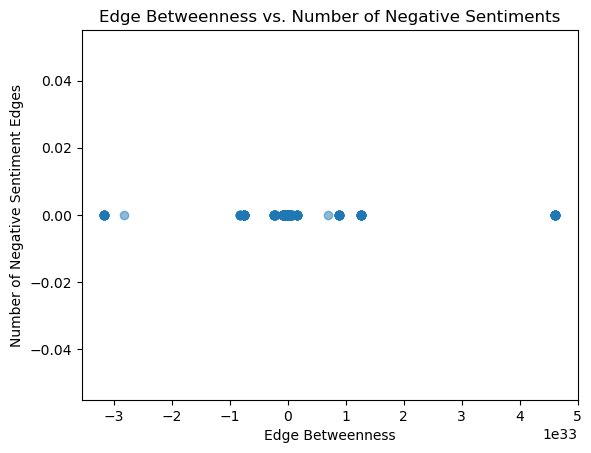

In [48]:
import snap
import matplotlib.pyplot as plt


# Calculate Edge Betweenness
NIdBtwH, EdgeBtwH = G.GetBetweennessCentr(1.0, False)

# Collect data for visualization
edge_ids = []
edge_betweenness_values = []
num_negative_sentiments = []

# Iterate over edges
for edge in G.Edges():
    edge_id = edge.GetId()

    # Get Edge Betweenness
    src, dst = edge.GetSrcNId(), edge.GetDstNId()
    key1 = snap.TIntPr(src, dst)  # Create a TIntPr (pair) object
    key2 = snap.TIntPr(dst, src)  # Create the reverse order TIntPr (pair) object

    # Check if the key exists in the hash table
    if EdgeBtwH.IsKey(key1):
        edge_betw = EdgeBtwH.GetDat(key1)
    elif EdgeBtwH.IsKey(key2):
        edge_betw = EdgeBtwH.GetDat(key2)
    else:
        # If neither key is found, print a message
        print(f"Edge {edge_id}: Neither key {key1} nor {key2} found in EdgeBtwH")
        continue

    # Retrieve the sentiment attribute for the edge
    try:
        sentiment = G.GetIntAttrDatE(edge_id, "sentiment")
        if sentiment == 1:  # Assuming 1 corresponds to negative sentiment
            print("found")
            num_negative_sentiments.append(1)
        else:
            num_negative_sentiments.append(0)
    except RuntimeError:
        # No sentiment attribute found for this edge
        num_negative_sentiments.append(0)

    edge_ids.append(edge_id)
    edge_betweenness_values.append(edge_betw)

    # Print details for each edge
    print(f"Edge {edge_id}: Edge Betweenness {edge_betw}, Sentiment {sentiment}")

# Plotting a scatter plot
plt.scatter(edge_betweenness_values, num_negative_sentiments, alpha=0.5)
plt.title('Edge Betweenness vs. Number of Negative Sentiments')
plt.xlabel('Edge Betweenness')
plt.ylabel('Number of Negative Sentiment Edges')
plt.show()
